**Create metadata.csv for test/validation datasets**

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
# Imports
import pandas as pd
import numpy as np
import json
import re

# Open file as a dataframe
# file_path = '/content/drive/My Drive/CSC490/CSC490 Project/latter_upload_chest_figures/latter_upload_chest_figures.csv'
# df = pd.read_csv(file_path)

In [ ]:
new_df = df.loc[:, ['pdf_hash', 'fig_uri', 's2_caption_cleaned']]
new_df['file_name'] = new_df['pdf_hash'] + '_' + new_df['fig_uri']
new_df = new_df.rename(columns={'s2_caption_cleaned': 'text'})
new_df.head(10)

,pdf_hash,fig_uri,text,file_name
0,c857a26a72635ad947f78e7b1e627e0e1997527f,5-Figure3-1.png,Images of 60yearold man with adenocarcinoma o...,c857a26a72635ad947f78e7b1e627e0e1997527f_5-Fig...
1,4b3aacae3e70aecfe3bbbc45e990f2b23c609aa2,3-Figure3-1.png,Chest Xray PA view Histopathology of skin le...,4b3aacae3e70aecfe3bbbc45e990f2b23c609aa2_3-Fig...
2,9e7edc46e64a1e5ecdafacc9f9f02afe1cfd26ae,2-Figure4-1.png,Chest CT also showed that lung metastasis sho...,9e7edc46e64a1e5ecdafacc9f9f02afe1cfd26ae_2-Fig...
3,3c4917340ecda1c30b4e1df8bfac04be3554f8a1,1-Figure1-1.png,Chest radiograph on admission showing enlargi...,3c4917340ecda1c30b4e1df8bfac04be3554f8a1_1-Fig...
4,3c4917340ecda1c30b4e1df8bfac04be3554f8a1,2-Figure2-1.png,Chest radiograph nine days after admission sh...,3c4917340ecda1c30b4e1df8bfac04be3554f8a1_2-Fig...
5,f27b6f6244938d1b993089f641b9216ffbd7a9fc,2-Figure1-1.png,Chest Xray showing extensive bronchopneumonia,f27b6f6244938d1b993089f641b9216ffbd7a9fc_2-Fig...
6,a7fddb4b1dfe75cc9b7b0145e2592dc10bd9fa12,2-Figure1-1.png,Computed tomography CT images during the clin...,a7fddb4b1dfe75cc9b7b0145e2592dc10bd9fa12_2-Fig...
7,c3e1db27d98f177c0616d1bc3d4476530e3980c7,2-Figure1-1.png,Chest xray showing bilateral infiltrates in t...,c3e1db27d98f177c0616d1bc3d4476530e3980c7_2-Fig...
8,13b33e7472613899b37a8be2b3531fe4f463a0ec,2-Figure1-1.png,Chest radiograph demonstrating diffuse bilate...,13b33e7472613899b37a8be2b3531fe4f463a0ec_2-Fig...
9,ffd536285dcd9b615e140b52f6c524ba7c0b10d8,2-Figure1-1.png,a Echocardiography shows left ventricular dil...,ffd536285dcd9b615e140b52f6c524ba7c0b10d8_2-Fig...


In [ ]:
# Save as new csv file
path = '/content/drive/My Drive/CSC490/CSC490 Project/test/metadata.csv'
new_df.to_csv(path, index=False)

**Test the current model**

In [7]:
!pip install git+https://github.com/huggingface/transformers.git@main

  Cloning https://github.com/huggingface/transformers.git (to revision main) to /tmp/pip-req-build-f8ns_dwy
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers.git /tmp/pip-req-build-f8ns_dwy
  Resolved https://github.com/huggingface/transformers.git to commit 2c658b5a4282f2e824b4e23dc3bcda7ef27d5827
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for transformers: filename=transformers-4.36.0.dev0-py3-none-any.whl size=8119970 sha256=6ff950409ded28942b254f427219a4f92421838e3bc11dace5462927b7dccc57
  Stored in directory: /tmp/pip-ephem-wheel-cache-45_vikg2/wheels/cf/59/82/6492402e887a68975030bf8c06532260abc16abb7ccd8127cc
Successfully built transformers
  Attempting uninstall: transformers
    Found existing installation: transformers 4.35.2
    Uninstalling transformers-4.35.2:
      Successfully uninstalled transformers-4.35.2


In [8]:
!pip install -q datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.5 MB/s eta 0:00:00


In [1]:
!pip install colab-xterm
%load_ext colabxterm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.6/115.6 kB 3.8 MB/s eta 0:00:00


In [4]:
%xterm

Launching Xterm...

<IPython.core.display.Javascript object>

In [9]:
import time
from datasets import load_dataset

dataset = load_dataset("imagefolder", data_dir="/content/drive/MyDrive/CSC490/CSC490 Project/test", split="train")

print(dataset[0])

Resolving data files:   0%|          | 0/301 [00:00<?, ?it/s]

Extracting data files: 0it [00:00, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

{'image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=610x442 at 0x7ACFE93D2FB0>, 'pdf_hash': 'd04216c6d22fb7517dbcd6086c82790e3a4c53df', 'fig_uri': '2-Figure3-1.png', 'text': ' Chest CT image in a bone window setting shows osteosclerotic lesions in the vertebral body of the thoracic spine arrow head and sternum white arrow as well as proliferative new bone formation over the right transverse process black arrow Bilateral pleural effusions and partial passive atelectasis of left basal lung are present'}


In [10]:
import torch
from torch.utils.data import Dataset, DataLoader

class ImageCaptioningDataset(Dataset):
    def __init__(self, dataset, processor):
        self.dataset = dataset
        self.processor = processor

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        encoding = self.processor(images=item["image"], text=item["text"], padding="max_length", return_tensors="pt")
        # print(encoding["pixel_values"].shape)
        # remove batch dimension
        encoding["input_ids"] = encoding["input_ids"][:, :512]  # Truncate if longer
        encoding["attention_mask"] = encoding["attention_mask"][:, :512]
        encoding = {k:v.squeeze() for k,v in encoding.items()}


        return encoding

In [11]:
from transformers import AutoProcessor, BlipForConditionalGeneration

processor = AutoProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

In [12]:
test_dataset = ImageCaptioningDataset(dataset, processor)
test_dataloader = DataLoader(test_dataset, shuffle=True, batch_size=6, drop_last=True)

In [13]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

def generate_caption(image_index, data):
  example = data[image_index]
  image = example["image"]
  width, height = image.size
  display(image.resize((int(0.3*width), int(0.3*height))))

  inputs = processor(images=image, return_tensors="pt").to(device)
  pixel_values = inputs.pixel_values

  generated_ids = model.generate(pixel_values=pixel_values, max_length=50)
  generated_caption = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

  result = []
  result.append(generated_caption)
  result.append(data[image_index]["text"])
  print(generated_caption)
  print(data[image_index]["text"])
  return result

In [14]:
print(device)

cuda


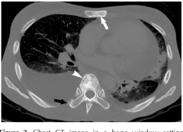

a ct scan with a ct scan
 Chest CT image in a bone window setting shows osteosclerotic lesions in the vertebral body of the thoracic spine arrow head and sternum white arrow as well as proliferative new bone formation over the right transverse process black arrow Bilateral pleural effusions and partial passive atelectasis of left basal lung are present


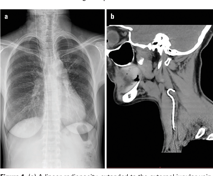

a radiograph of the chest and a radiograph of the chest
 a  linear radiopacity extended to the external jugular vein was observed on posteroanterior chest Xray b  0038inch  guidewire was observed on computed tomography and the distal part of the guidewire was detected in the external jugular vein


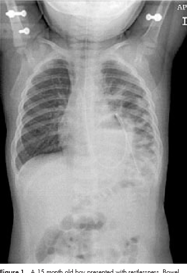

a chest with a small chest and a small chest
  15 month old boy presented with restlessness Bowel sounds were heard on auscultation in the left hemithorax Chest x ray examination confirmed the diagnosis of DH


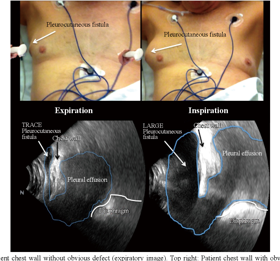

a picture of a man with a cervical surgery procedure
 Top left patient chest wall without obvious defect expiratory image Top right Patient chest wall with obvious defect inspiratory image Bottom left ultrasound image in expiratory phase demonstrating pleural effusion but only trace pleurocutaneous fi stula Bottom right ultrasound image in inspiratory phase demonstrating pleural effusion and large pleurocutaneous fi stula


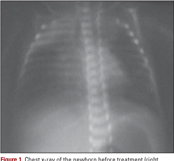

figure 1 chest chest view of the non retrant lid
 chest xray of the newborn before treatment right partial atelectasis


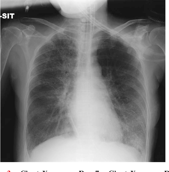

chest xrays and chest xrays
 Chest Xrays on Day 7 Chest Xray on Day 7 showed further improvement in the bilateral lungs


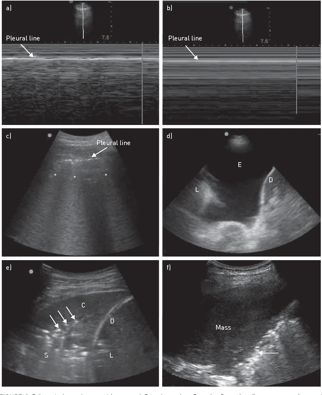

the ultrasounds are shown in the left side of the chest
FIGURE 2 Selected chest ultrasound images a Seashore sign Granular “seashore” appearance of normal lung sliding on  mode b Barcode sign Horizontal “barcode” appearance with loss of lung sliding on  mode c Blines Asterisks indicate comet tail artefacts arising from the pleural line Blines d Simple pleural effusion “” indicates anechoic freeflowing effusion “” indicates compressed atelectatic lung “” indicates diaphragm e Consolidation “” indicates consolidation “” indicates diaphragm “” indicates liver “” indicates serrated distal margins of the consolidation Arrows indicate air bronchograms f Lung tumour The arrow indicates the smooth distal margin of the mass


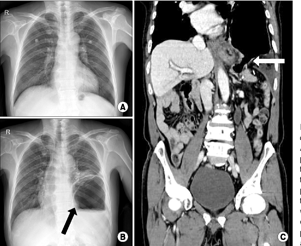

the chest and chest are shown in this image
 The patient had a normal chest Xray four months earlier   new chest Xray  and computed tomography  revealed that the stomach had migrated into the thoracic cavity  black arrow  points to the stomach which is extremely inflated by ingested air  white arrow  points to a 5 cm defect of the diaphragm The diaphragmatic dome is suspected to be a perforated site


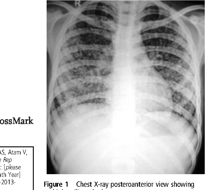

a chest with a small chest and a large chest with a small chest
 Chest Xray posteroanterior view showing multiple miliary shadows


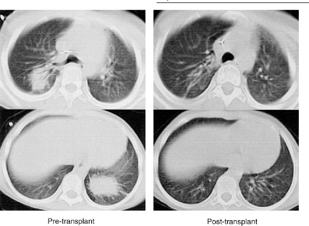

the ctt mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest CT scan before and after unrelated HLAmatched BMT Pulmonary abscesses in both lungs disappeared following BMT


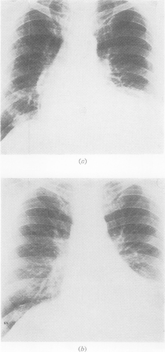

the left side of the chest shows the left side of the chest, and the right side shows the right
FIG 2 a Chest radiograph showing a large left ventricular aneurysm in a 58yearold man b The postoperative film two months after resection of the aneurysm showing a considerable decrease in heart size


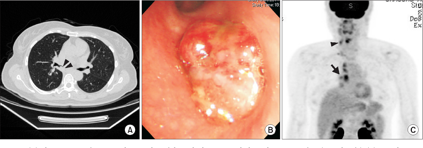

the left side of the left side of the left side of the left side of the left side of the
  Chest computed tomography reveals endobronchial mass in right bronchus intermedius arrowheads  Bronchoscopy shows lobulated endobronchial mass  Multifocal fluorodeoxyglucose uptake in right bronchus intermedius arrow and right paratracheal area arrowhead on preoperative positron emission tomography—computed tomography


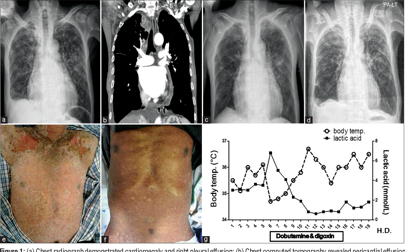

a chest with a large, flat, and small chest
 a Chest radiograph demonstrated cardiomegaly and right pleural effusion b Chest computed tomography revealed pericardial effusion and necrotic conglomerated lymphadenopathies c Chest radiograph after 5 weeks of anti‑tuberculosis medication showed decreased pleural effusion d Chest radiograph showed increased pleural effusion e Generalized cutaneous exanthema consisting of crusts and erythematous plaques on patient’s trunk f After 15 days of treatment the skin lesions had markedly healed g Graph showing the changes in body temperature and lactic acid Hypothermia continued for 3 days HD Hospitalization day Dobutamine and digoxin means the period of inotropics treatment Dobutamine and digoxin were used from HD6 to HD 15


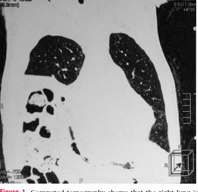

a radiograph of a patient's lungs
 Computed tomography shows that the right lung is significantly compressed and that the transverse colon appears in the right chest cavity


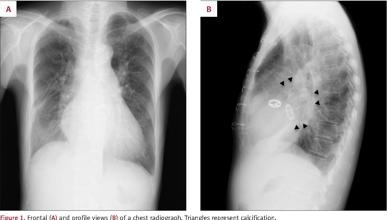

a chest with a small fracture and a large fracture
 Frontal  and profile views  of a chest radiograph Triangles represent calcification


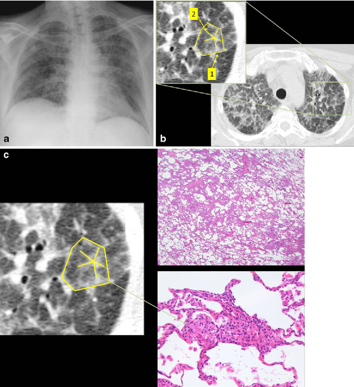

the left lung is shown in the upper left lung, and the right lung is shown in the upper right
 Hypersensitivity pneumonitis a Chest radiograph showed patchy distribution of areas with increased lung density There was also an increase in the linear pattern in both lungs b On CT a crazypaving pattern was seen with a geographic distribution of groundglass opacities with the superimposition of thickened inter 1 and intralobular 2 septa The findings were seen predominantly in the upper lung areas c


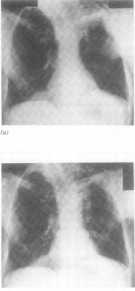

two images of the chest and chest, one shows a large, flat, flat, flat, flat, flat, flat, flat, flat
 Case 2 a Radiograph taken before cavernoscopy showing an aspergilloma in the left upper lobe b chest radiograph September 1983 showing recurrence ofthe fungus ball


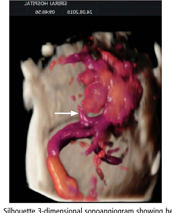

a photo of a person with blood on their stomach
 Silhouette 3dimensional sonoangiogram showing hepatic vessels ascending through a small defect at the diaphragm arrow This was a case of a fetus at 26 weeks with a subtle liverup rightsided congenital diaphragmatic hernia Because Bmode ultrasound may not differentiate the echogenicity between the liver and lung of the fetus the use of color Doppler sonoangiography may help reveal evidence of the liver being in the chest


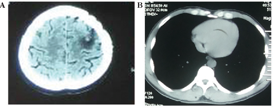

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Followup CT scans performed 8 months after surgery  Followup cranial CT scan revealed no intracranial tumor recurrence  Chest CT indicated that the chest lesions were stable CT computed tomography


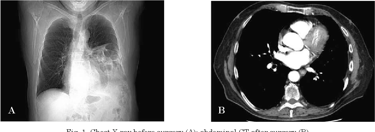

the left side of the chest shows the left side of the chest and the right side of the chest shows
 Chest Xray before surgery  abdominal CT after surgery 


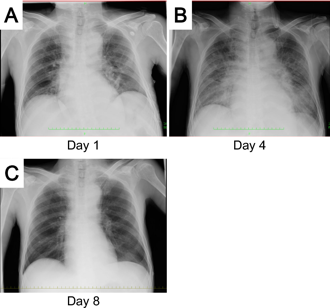

the chest and chest are shown in three different views
 Chest Xray on the day of admission  and days 4  and 8  after admission


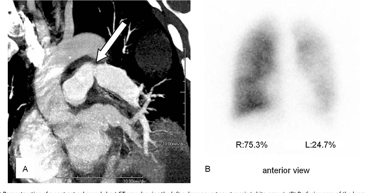

a dog's left side shows the same size of the dog's left side
  Reconstruction of a contrast enhanced chest CT scan showing the left pulmonary artery stenosis white arrow  Perfusion scan of the lungs showing a reduced perfusion of the left lung  right lung  left lung


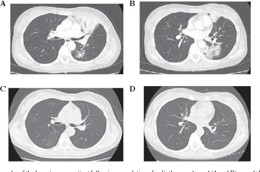

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest computed tomography of the breast cancer patient following completion of radiotherapy showed  and  consolidation with air bronchograms in


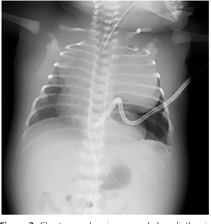

a chest with a radiograph showing the chest and the radiograph showing the chest
 Chest xray showing expanded cardiothymic silhouette and persistent pneumothorax despite chest tube insertion


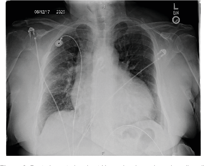

a chest with a radiograph showing the lungs
 Posterioranterior chest Xray showing enlarged cardiac silhouette and vascular congestion


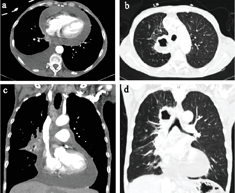

the left side of the chest shows the left side of the chest, and the right side shows the right
 a CT chest axial view showing pericardial effusion b CT chest axial view showing in pulmonary window showing air filled cavity with airfluid level c CT chest coronal view showing pericardial effusion d CT chest coronal view in pulmonary window


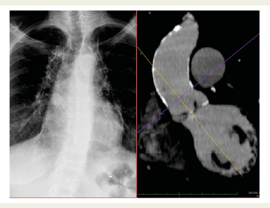

a chest x - ray with a cross section
 Chest Xray left and computed tomographyscan right of a 76yearold female with severe aortic stenosis showing heavy calcifications of the ascending aorta although the lady had not any copathologies and the predicted operative mortality was only 28 with the Logistic EuroScore operative risk was deemed to be prohibitive by the Heart Team due to the presence of porcelain aorta and the patient underwent transcatheter aortic valve implantation


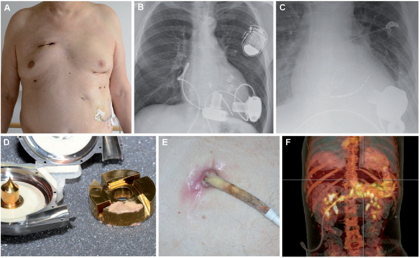

a col of images showing the different types of the lungs
  Less invasive left ventricular assist device LVAD implantation techniques may preserve pericardial integrity and facilitate later median sternotomy in bridge to transplant patients  Chest radiograph showing 2 centrifugal continuous flow pumps HeartWare HVADV   Medtronic Minneapolis MN USA for biventricular support   perfectly aligned inflow cannula of the Heartmate 3V  within the inflow of the left ventricle and away from the septum may prevent low flow and pump thrombosis  Pump thrombosis is a major complication in LVAD therapy The image shows the impeller of an explanted HeartWare ventricular assist device with fibrin coating  Peripheral driveline infections may be treated by antibiotic and local surgical means  Positron emission tomographycomputed tomography scans may uncover ascending infection of the LVAD here a Heartmate II


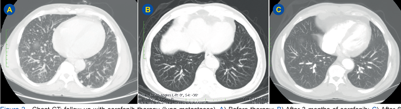

the left side of the mri shows the left side of the mri and the right side of the mri
  Chest CT followup with sorafenib therapy lung metastases  Before therapy  After 3 months of sorafenib  After 6 months of sorafenib


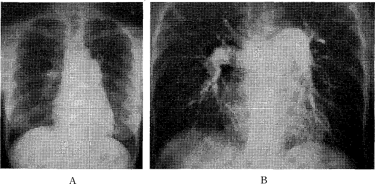

the left side of the left side shows the same areas of the left side, and the right side shows
 Chest Xray  and pulmonary angiography  on first admission in 1984 Chest Xray showed a prominent right ventricular outflow tract  and majorvessel thromboembolismwas not shown on pulmonary angiography 


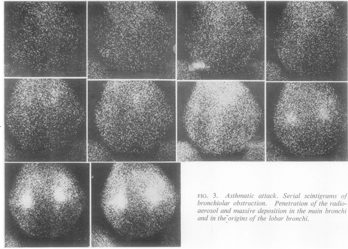

a black and white photo of a bunch of flowers
FIG 4 Carcinoma of a division of the left upper lobe bronchus   Chest film anterior and left lateral views a slightly opacified high juxtahilar lesion is seen in the left lung   Perfusion scan anterior and dorsal views hyporadioactivity of the left lung  Left lateral view note the hyporadioactive area in the anterior region of the left upper lobe    Inhalation scan anterior dorsal and left lateral views there is a good distribution of the aerosol except for an angular hyporadioactive area in the anterior part ofthe left upper lobe This case illustrates two scan patterns segmental bronchial obstruction of the upper lobepoor perfusion and ventilation andpathological pulmonary dead space of the rest of the left lung poor perfusion with normal ventilation caused by metastatic compression of the pulmonary artery


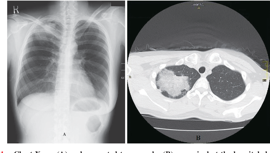

the left chest and right chest are shown in this image
 Chest Xray  and computed tomography  on arrival at the hospital showed pulmonary infiltration localized in the right upper lobe


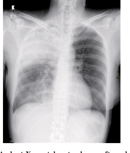

a chest xray with a large chest
  chest Xray taken ten hours after admission indicated a rapid increase in pulmonary opacities


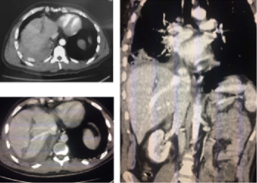

mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Images of abdominal CT showing the path of the chest tube thru the liver next to hepatic right and middle hepatic vein


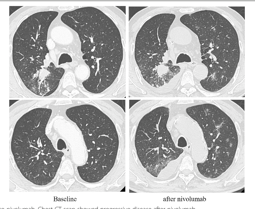

the brain is shown in four different sections, each with a large, small, and small brain
 Clinical responses to nivolumab Chest CT scan showed progressive disease after nivolumab


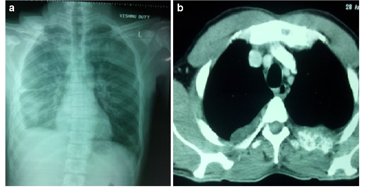

a radiograph of the chest and a radiograph of the chest
 Chest Xray of the patient showing the presence of pleural effusion in right hemithorax a and contrast enhanced CT scan of chest showing a lytic expansile lesion involving the posterior part of right 6th rib b


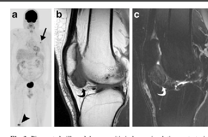

the knee is shown in this image and shows the fracture
 Pigmented villonodular synovitis in knee simulating metastasis in a patient with suspected lung cancer a Coronal maximumintensity projection image from PET scan shows foci of avidity in a small left lung nodule arrow and in an unsuspected mass in the right knee arrowhead SUV102 Sagittal T1weighted b and fatsuppressed T2weighted c MR images show a welldefined mass in Hoffa fat pad with low signal intensity on both images consistent with haemosiderin content curved arrows Biopsy results confirmed pigmented villonodular synovitis in right knee and metastatic melanoma in left lung nodule from patient’s prior melanoma of left chest wall


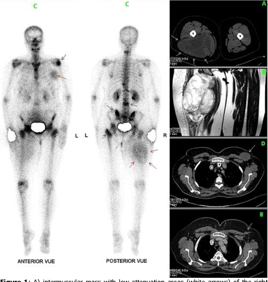

the left side of the chest shows the different areas of the patient's left and right side
  intermuscular mass with lowattenuation areas white arrows of the right proximal thigh on the CT scan  intermuscular mass with marked high signal intensity on T2weighted MR images and marked high signal intensity on T2weighted MR images  bone scintigraphy showing multiple hot spots over the proximal epiphysis of the left humerus sternum T1012 and L23 and S1 vertebrae suggestive of skeletal metastases black arrows in addition to a soft tissue uptake projected over the right proximal thigh and the left mammary gland corresponding respectively to the primitive tumour red arrows and a breast metastasis red arrow  left breast metastasis revealed as a low attenuation area white arrow on chest computerised tomography  regression of the breast metastasis white arrow on a followup CT tree years later


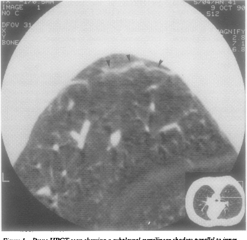

a black and white image of a brain
Figure  Prone HRCT scan showing a subpleural cuilinear shadow parallel to inner chest wall see arrows


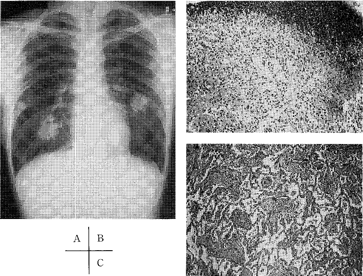

the left side of the chest shows the left side of the chest, and the right side shows the right
  Chest radiograph on admission showing multiple nodular shadow in bilateral lung field  The transbronchial biopsy specimen from right B6 showing necrotic granuloma or basophilic necrosis with granulocytes surrounded by epithelioid cells HE stain xlOO  The thoracoscopic biopsy specimen of right B4 showing typical polypoid granuloma


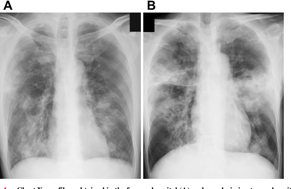

a chest with a large, flat, and small chest
 Chest Xray films obtained in the former hospital  and on admission to our hospital in February 2017  Bilateral infiltrates mainly in middle field progressed rapidly within about one week


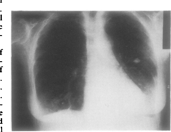

the lungs are not in the lungs, but they are not in the lungs
Figure  Chest radiograph showing an enlarged cardiac silhouette pleuralfluid and an infiltrate at the left base


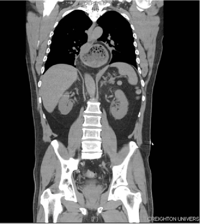

a ct scan shows the chest and the chest
 CT chest and abdomen demonstrating an intrathoracic stomach


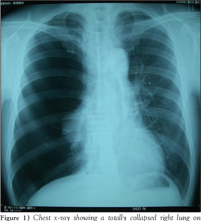

a chest radiograph showing the chest and chest
 Chest xray showing a totally collapsed right lung on admission


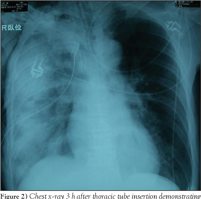

the chest is shown with a large, open chest
 Chest xray 3 h after thoracic tube insertion demonstrating ipsilateral pulmonary edema


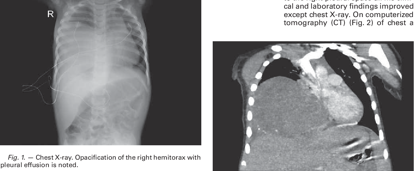

the left side of the chest shows the left side of the chest, and the right side shows the right
 — Chest Xray Opacification of the right hemitorax with pleural effusion is noted


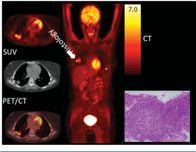

the image shows the different types of the tumor
  28 yearold woman presented with asymptomatic pulmonary nodules associated with increasing EBV viral load in the peripheral blood four months following lung transplantation Transaxial FDGPET CT and fused PETCT images of the chest left maximum intensity projection center and histology of pulmonary nodule right FDG PETCT showed a bilobar pulmonary nodule in the right lung white arrow and a lesion in the liver and left chest wall Histological analysis of a core needle biopsy of the pulmonary nodule revealed an EBVdriven diffuse large CD20positive lymphoid proliferation compatible with a monomorphic PTLD type DLBCL NOS of nongerminal center Bcell origin SUV standardized uptake value


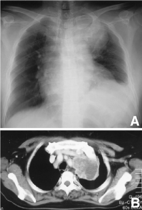

a chest xray with a radiograph of the chest
  Chest radiograph showing a tumor in the upper lobe of the left lung  Chest computed tomography scan showing the tumor in the left lung


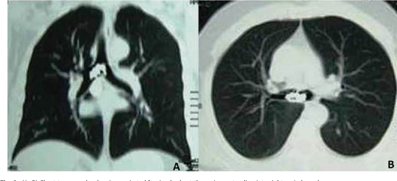

the lungs are shown in this image
   Chest tomography showing aspirated foreign body at the carina extending into right main bronchus


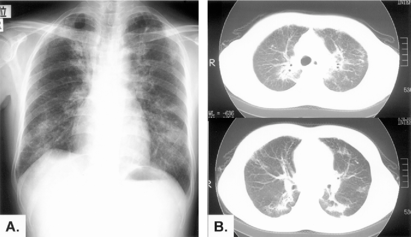

the chest and chest are shown in this image
  The chest radiography showing reticulonodular pattern in the upper and lower right lobes and in all left lobes  Chest computed tomography CT scan demonstrating bilateral diffusely scattered reticulonodular pattern with inner zone predominance and peripheral infiltrative shadows in both lungs


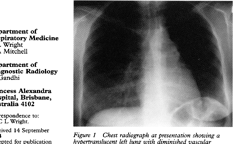

the chest is shown with the chest and chest
 Chest radiograph at presentation showing a hypertranslucent left lung with diminished vascular markings and a small left hilum


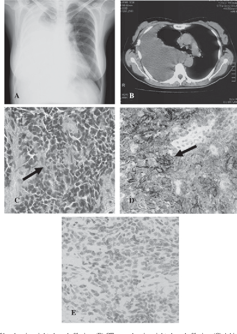

the left side of the chest shows the left side of the chest, and the right side shows the right
 Case 2  Chest Xray film showing right pleural effusion  CT scan showing right pleural effusion   biopsy specimen from a pleural lesion


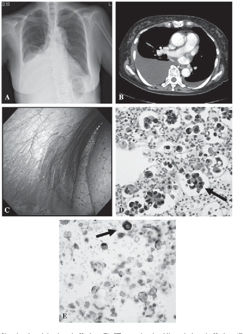

the left side of the chest shows the different areas of the chest and the right side of the chest
 Case 3  Chest Xray film showing right pleural effusion  CT scan showing bilateral pleural effusion  Thoracoscopic image showed no lesion of the parietal pleura  Pleural fluid cell block indicating adenocarcinoma Hematoxylin and eosin staining x400  Immunohistochemical examination of the pleural fluid cell block showed positivity for CA125 x400


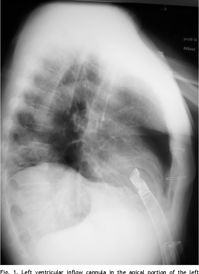

a chest with a large lump in the middle
 Left ventricular inflow cannula in the apical portion of the left ventricle visualized by the postoperative chest Xray lateral view


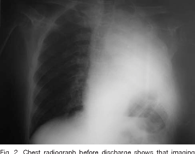

chest radiograph of a patient
 Chest radiograph before discharge shows that imaging findings have improved


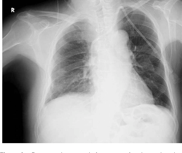

a chest with a large, open chest, and a small chest with a large, open chest
 Postoperative control chest xray showing replaced permanent catheter to the left side opposite side and traces of postoperative sutures


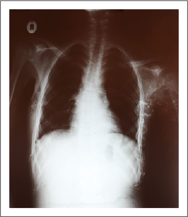

a chest with a large white lung in the middle
 Repeat posterior–anterior chest xray showing resolution of mediastinal widening


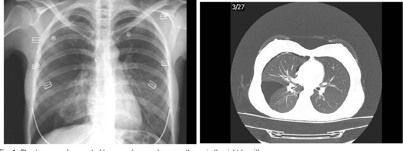

the left side of the chest shows the left side of the chest and the right side of the chest shows
 Chest xray and computed tomography reveal pneumothorax in the right hemithorax


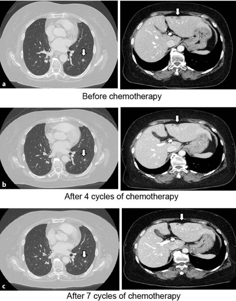

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 CT of the chest before chemotherapy a after 4 cycles of chemotherapy b and after 7 cycles of chemotherapy c The size of the lung and liver metastases had decreased b and no disease progression was observed c


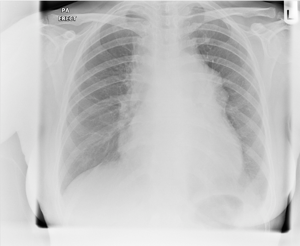

a chest xray with a large rib fracture
 Chest xray on admission


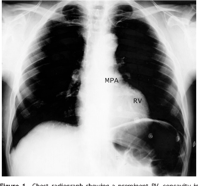

figure 1 chest radiograph showing pulmonary cavity in the upper part of the chest
 Chest radiograph showing a prominent RV concavity in the main pulmonary artery area and a lifted apex with diminished pulmonary vascular markings MPA main pulmonary artery RV right ventricle


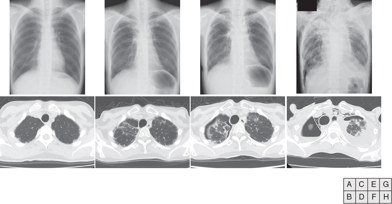

the chest and chest are shown in this image
 Chest radiography and computed tomography images showing bilateral upper lung volume loss with pleural thickening   Before haematopoietic transplantation No abnormal findings are observed   Four years after haematopoietic stem cell transplantation HSCT Bilateral pleural thickening of the pulmonary apex is observed   Five years after HSCT Air space persists in the thoracic cavity Full lung expansion cannot be achieved due to repeated pneumothorax and lung contraction   Eight years after HSCT 1 week before death Progressive lung contraction and mediastinal emphysema is observed


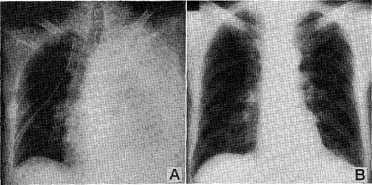

a black and white image of a man's chest
 Chest radiograph findings before chemotherapy  and 2 weeks after chemotherapy 


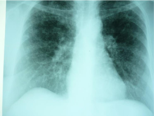

a chest with a large lung in the middle
 – Chest Xray on admission demonstrates enhanced reticularity on the whole


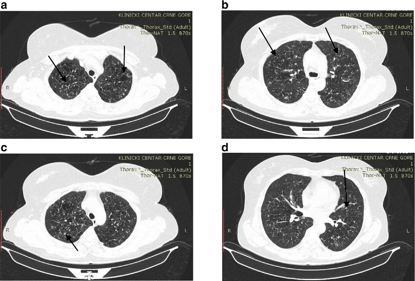

the four mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 – Highresolution CT of the chest a a few thinwalled lesions and a majority of thickwalled lesions b cystic changes that range from a couple of millimeters to 2 cm in diameter Furthermore c pulmonary nodules and d bleak centrilobular nodules measuring up to 5 mm in diameter are demonstrated In addition polymorphic lesions are present diffusely and bilaterally with the exception of outermost dorsobasal aspects of both lungs


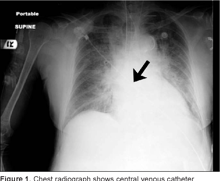

chest xrays with a small, flat, flat, flat, flat, flat, flat, flat
 Chest radiograph shows central venous catheter overlying left internal jugular vein traversing the mediastinum


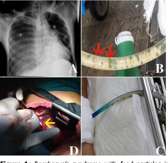

a col of images showing the different types of the chest
 Boerhaave’s syndrome with food particles in chest tube  chest xray showed rightsided tension pneumothorax  rice and green onions red arrows appeared in the chest tube  methylene blue which was swallowed came out through the chest tube  a part of the nasogastric tube yellow arrow was found during the thoracotomy process


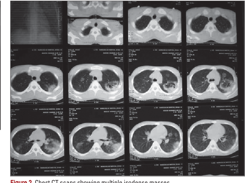

a ct scan with multiple ct scans
 Chest CT scans showing multiple isodense masses


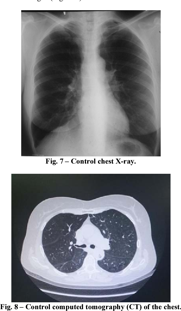

figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure figure
 – Control computed tomography CT of the chest


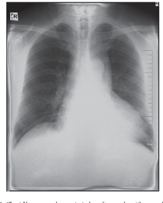

a chest with a radiograph showing the chest and chest
 Chest ‑ray scan demonstrated cardiomegaly with normal pulmonary vasculature


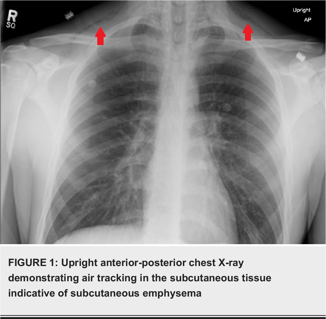

figure 1 right anterior - pestootis x - ray demonstrating submed
FIGURE 1 Upright anteriorposterior chest Xray


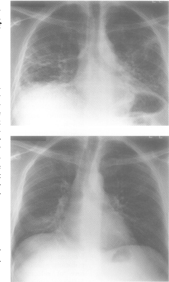

the chest and chest are shown in this image
  Chest radiograph showing extensive peripheral and lower zone ground glass and confluent nodular shadowing with considerable loss of volume in the lower lobes  Following right lung transplantation the native left lung appears normal the right middle lobe is collapsed


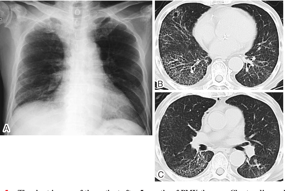

the chest and chest are shown in this image
 The chest images of the patient after 5 months of PMX therapy Chest radiography  and HRCT  and  show remarkable improvement


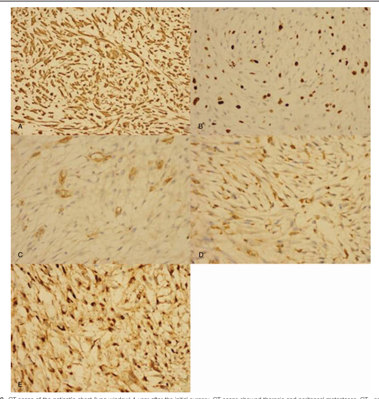

imr - 1 antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody antibody
 CT scans of the patient’s chest lung window 1 year after the initial surgery CT scans showed thoracic and peritoneal metastases CTcomputed tomography


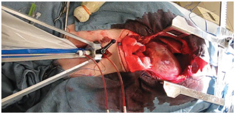

a man is laying down in a hospital bed
 Openchest model for ultrasound visualization


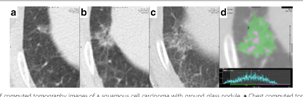

a photo of a radiographgraphgraphgraphgraphgraphgraphgraphgraphgraphgraphgraphgraphgraphgraphgraph
  series of computed tomography images of a squamous cell carcinoma with ground glass nodule a Chest computed tomography CT image showing a 7mm ground glass nodule GGN in the right lower lobe when the lesion was first noted b Chest CT obtained 1 year after a the GGN has enlarged to 18 mm c Chest CT image obtained 15 year after a the GGN has enlarged to 24 mm and a solid component has developed d In a semiautomated threedimensional volumetric “GGN analysis” of c the ground glass opacity component green area between −800 and −301 Hounsfield units accounted for 64 of the tumor in contrast to the remaining solid component purple area ≧−300 Hounsfield units


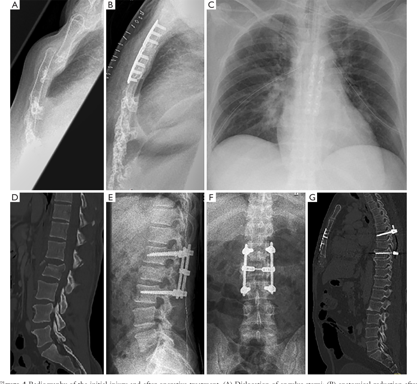

the chest and chest are shown in this image
 Radiography of the initial injury and after operative treatment  Dislocation of angulus sterni  anatomical reduction after anterior plating  chest Xray postoperative shows two sternal plates and chest tubes bilateral  unstable fracture of L2  internal fixator L1L3 lateral view  anteriorposterior view  the alignment of the trunk has been restored through a combined stabilization of the sternum and the spinal column


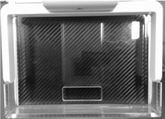

a white microwave oven with a black door
 Customized compression plate We pierced the compression plate such that the center was at a position 35 cm from the chest wall an area through which an ultrasound probe was to be placed


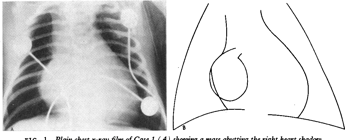

a chest with a radiographgraph showing the chest and chest
FIG 1 Plain chest xray film of Case 1  showing a nmass abutting the right heart shadow This is outlined in the accompanying line drawing 


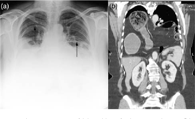

the chest and chest are shown in this image
 Chest Xray suggested bilateral hemidiaphragmatic elevation black arrows due to suspected diaphragmatic palsy or eventration a Coronal CT scan findings were equivocal b


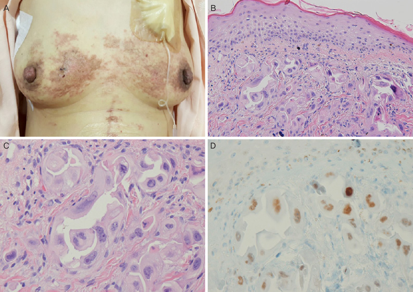

a col of three images of breast cancer
  Multiple skin metastases on the anterior chest wall including bilateral breast skin pruritus erythematous patches metastatic clear cell carcinoma in the dermis  Tumor cells exhibit abundant eosinophilic cytoplasm and marked nuclear atypia in hematoxylineosin staining ×200  hematoxylineosin staining ×400  Immunohistochemistry for progesterone receptor is weakly positive within the metastatic clear cell carcinoma ×400


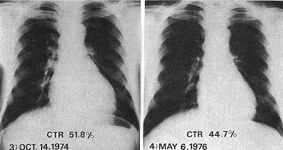

a black and white image of a chest with a small, black, and white image of a chest with
 Chest  ray of a patient with beriberi before and after the thiamine treatment Heart dilatation was recovered after the thiamine treatment13


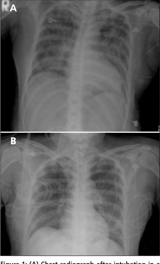

a chest xray with a chest xray showing the chest xray
  Chest radiograph after intubation in a 50yearold woman showing bilateral interstitial patchy infiltrations suggestive of diffuse pulmonary edema  Chest radiograph obtained 29 hours after intubation showing resolution of infiltrations


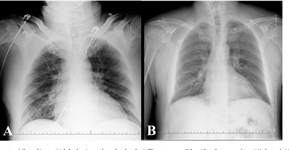

a chest xray with a chest xray and a chest xray
 Chest radiograph demonstrates bilateral interstitial shadowing and patchy alveolar infiltrates compatible with pulmonary edema  that subsided soon after admission 


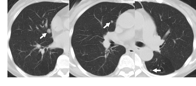

the ctd mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest computed tomography showed multiple metastases in the bilateral lungs white arrows


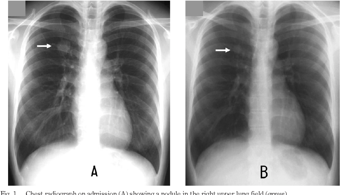

a chest with a large, open chest and a small chest with a large, open chest
 Chest radiograph on admission  showing a nodule in the right upper lung field arrow Chest radiograph at mass screening one year earlier   the nodule is visible and appears smaller than in  above arrow


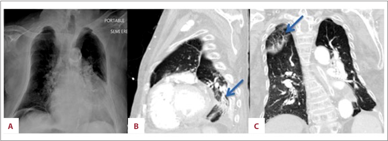

a radiograph of the chest and a radiograph of the chest
  Chest xray on admission demonstrating a retrocardiac infiltrate  Computed tomography CT chest sagittal plane demonstrating left lower lobe infiltrate  CT chest coronal plane demonstrating right upper lobe infiltrate


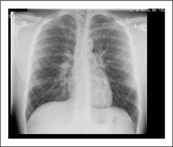

the chest is shown in this image
 Chest radiograph taken following admission of patient to the ED The film fails to show the presence of the plastic ring cap in the upper airway The upper airway is not entirely visualized and there are subtle signs of chest hyperinflation


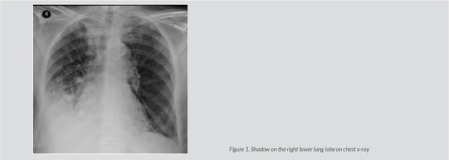

a chest radiograph showing the chest and chest
 Shadow on the right lower lung lobe on chest xray


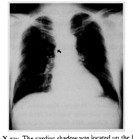

xray radiographyic shadow toward the presence of the xray radiographyic shadow toward the presence of the xray radiographyic shadow
 Chest Xray The cardiac shadow was located on the left side An azygos knob arrow was observed on the right margin of the cardiac silhouette


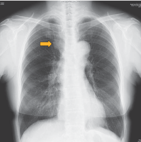

a chest with a small yellow arrow pointing up to the chest
  chest Xray taken at the time of hospital admission The film showed a mass in the right upper anterior mediastinum arrow


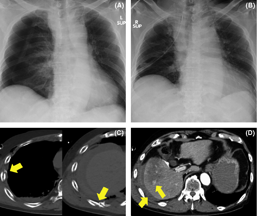

the left side of the chest shows the left side of the chest and the right side of the chest
  Chest radiograph showing a right pneumothorax with a mediastinal shift and  a released pneumothorax after an intercostal tube drain is inserted  Chest contrastenhanced computed tomography CT scan showing right lateral and posterior displaced rib fractures and a small right hemorrhagic pleural effusion  Abdominal contrastenhanced CT scan showing a hypodense lesion in the right liver lobe with extravasation of the contrast agent and ascites around the liver


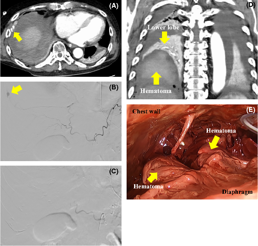

the left side of the mri shows the left side of the mri and the right side of the mri
  Chest contrastenhanced computed tomography CT scan showing a massive pleural effusion and extravasation of the contrast agent in the chest wall near the crus of the diaphragm   contrast agent leak is arising from the right inferior phrenic artery IPA and pseudoaneurysm and  selective angiography of the celiac artery confirms a complete occlusion of the right IPA and no leak of the contrast agent after embolization  Chest contrastenhanced CT showing a right hemorrhagic pleural effusion and the collapsed right lower lobe  Intraoperative views showing a thickened and fragile capsule covering the huge hematoma


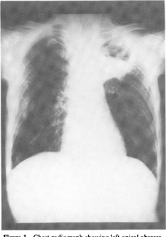

a chest with a large lung in the middle
 Chest radiograph showing left apical abscess


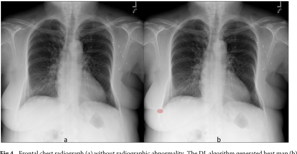

a chest with a small red dot on the chest
 Frontal chest radiograph a without radiographic abnormality The DL algorithm generated heat map b labels false positive pleural effusion on the right side


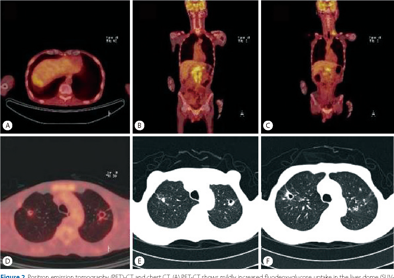

the brain and its structures
 Positron emission tomography PETCT and chest CT  PETCT shows mildly increased fluodeoxyglucose uptake in the liver dome SUVmax  36   Multiple FDG uptake is noted in retroperitoneal gastrohepatic and left supraclavicular lymph nodes  Cavitary pulmonary nodules is also noted in both upper lobe   ChestCT shows multiple thickwalled cavitary lesion branching linear opacities and clustered centrilobular nodules at both upper lobe


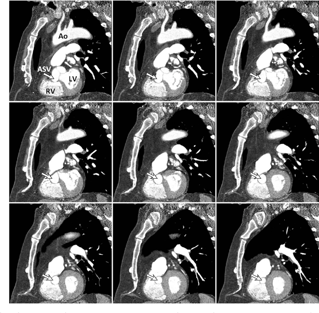

a series of images showing the different areas of the brain
 Chest CT angiography CT angiography oblique sagittal views of the sinus of Valsalva aneurysm This series of images demonstrates the enlargement of the right sinus of Valsalva arrow and subsequent slices reveal the extent of aneurysmal dilatation and protrusion into the right ventricle Ao aorta ASV aneurysm of the sinus of Valsalva LV left ventricle RV right ventricle


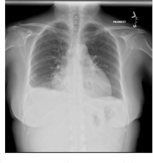

a chest x - ray with a large, open chest
 Chest Xray at time of initial diagnosis of PAH


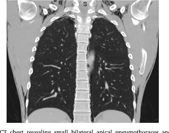

chest x - ray - ct scan
 CT chest revealing small bilateral apical pneumothoraces and neck subcutaneous emphysema


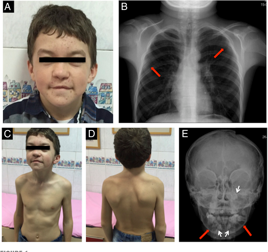

a child with a chest and chest, and a chest with a chest
FIGURE 1  An incomplete left unilateral cleft lip coarse face with thick eyebrows minimal frontal bossing and mild hypertelorism are shown  Posteroanterior chest radiograph showing a bifi d fourth rib on the left a fi fth rib on the right arrows and right high scapula Sprengel deformity  and  Multiple small nevi on the trunk are shown  Skull radiograph showing odontogenic keratocyts in the mandibula red arrows and mandibular and maxillary supernumerary and unerupted teeth white arrows


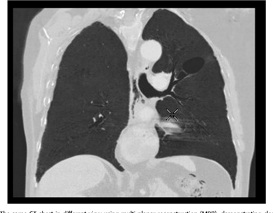

the chest is shown with a small, flat, flat, flat, flat, flat, flat, flat
 The same CT chest in different view using multiplanar reconstruction MPR demonstrating clearly the connection between the aspergillomacontaining cavity and the left main bronchus


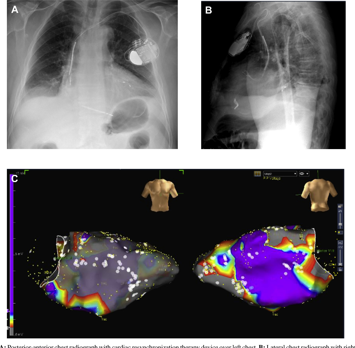

the left side of the chest shows the different areas of the chest and the right side of the chest
  Posterioranterior chest radiograph with cardiac resynchronization therapy device over left chestB Lateral chest radiograph with right ventricular lead visualized in the apex  Endocardial voltage map Ensite St Jude Minneapolis MN of the left ventricle at standard scar settings 05–15 mV demonstrating very large septal anterior and apical scar with areas of preserved voltage in midinferior and midlateral walls white dots 5 ablation lesions


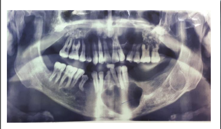

a radiograph of a human skull
 Orthopantomogram shows multiple odontogenic keratocysts in both maxilla and mandible  Chest xray revealed a bifid rib


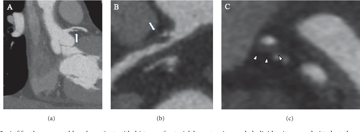

the left side of the left side shows the different areas of the left side of the left side, and
  fiftythreeyear oldmale patient with history of arterial hypertension and dyslipidemia was admitted at the emergency department for atypical chest pain Cardiac computed tomography acquired during hospitalization showed in multiplanar reconstruction a soft plaque determining stenosis of 70 in proximal left anterior descending artery a b arrow Cross sectional images showed positive remodeling of a soft plaque c arrowhead


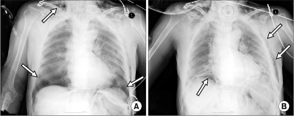

a chest with a fracture and a fracture in the left side
  portable chest radiograph  shows bilateral pneumothoraces pneumomediastinum pneumoperitoneum and subcutaneous emphysema over both chest walls neck and shoulder Followup chest radio graph  after the leftsided closed thora costomy revealed slight improvement in the pneu mothorax


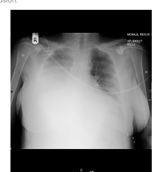

a chest with a radiograph showing the chest and chest
 Chest Xray at presentation shows a large right pleural effusion


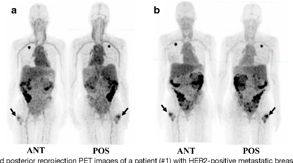

a and b are two different types of breast cancer
 Anterior and posterior reprojection PET images of a patient 1 with HER2positive metastatic breast cancer on a day 3 and b day 6 following 89Zrtrastuzumab administration demonstrate greater tracer uptake in the right femoral metastatic lesion without other significant change in tracer biodistribution on day 6 compared to day 3 The area of intense activity in the right chest is related to administration of 89Zrtrastuzumab via a port catheter


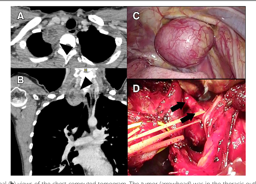

a ct scan of the brain tumor tumor in which is visible
 Axial a and coronal b views of the chest computed tomogram The tumor arrowhead was in the thoracic outlet and adjacent to the right brachiocephalic artery and right subclavian vein Intraoperative findings with videoassisted thoracoscopic surgery VATS c and the transmanubrial osteomuscular sparing approach TMA d The tumor was safely resected through the dual approach of VATS and TMA after encircling the right brachiocephalic artery arrow


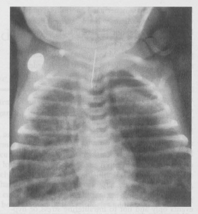

a black and white image of a chest
 Chest radiograph of a fullterm infant with meconium aspiration showing coarse interstitial


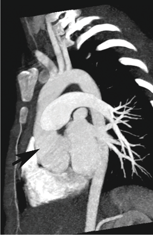

a ct scan with a small, white, and black area
 Marfan syndrome  7yearold male with Marfan syndrome referred for thoracic aortic evaluation Maximum intensity projection MIP reformatted image from a chest computed tomography angiography CTA examination shows an aneurysmal aortic root arrow with effacement of the sinotubular junction producing the socalled “tulip bulb” appearance


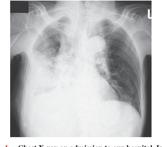

chest x - ray - x - ray - x - ray - x - ray x - ray x - ray x - ray x - ray
 Chest Xray on admission to our hospital Infiltrations and atelectasis in right middle and lower lung field were observed


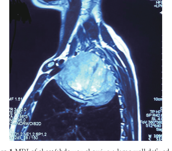

a radiograph of a person with a large, white, lumpy, lumpy, lumpy, lumpy, lumpy, lump
 MRI of chestabdomen showing a large well defined mass lesion in the right upper lobe in case 1


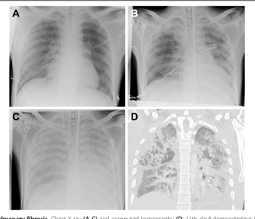

the chest and chest are shown in four different views
 Progressive pulmonary fibrosis Chest Xray AC and comput fibrosis on day 3  9  and 12 


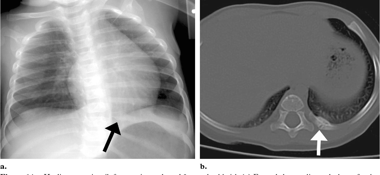

a radiograph of the chest and a radiograph of the chest
 Healing posterior rib fracture in an abused 2monthold girl a Frontal chest radiograph shows focal widening of the posterior left ninth rib arrow b Axial CT scan of the chest windowed for bone detail shows the posterior rib fracture with callus arrow


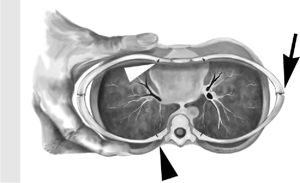

the ct scan is a large, open, bone that is located in the middle of the ct scan
 Rib fracture mechanism in tight squeezing Diagram of the midthorax during tight squeezing reveals anteroposterior compression which causes compression and fracture of the ribs laterally arrow There is hyperextension of the posterior rib ends over the transverse process with fracture of the ventral cortex black arrowhead Anteriorly the chest wall compression leads to inward bending of the anterior ribs and fracture white arrowhead


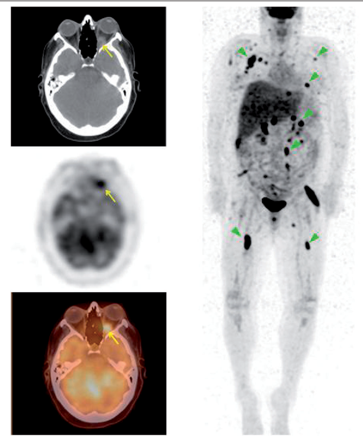

the left side of the left side shows the left side of the left side of the left side of the
  52yearold man presenting with abdominal adenopathy and blastic bone lesions on CT with unknown primary PETCT demonstrated widespread malignancy including an FDGavid lesion in the right medial orbit with associated soft tissue thickening as seen above SUVmax 48 Biopsy of a chest wall node revealed poorly differentiated nonsmall cell carcinoma with neuroendocrine features suggestive of a gastrointestinal primary


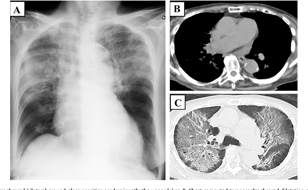

the chest and chest are shown in this image
  Chest radiography showed bilateral groundglass opacities predominantly the upper lobes  Chest computed tomography showed dilatation of the pulmonary trunk  Chest computed tomography showed groundglass opacity without bronchial dilatation honeycombing and pleural effusion


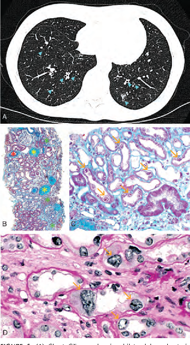

the left side of the left side shows the different areas of the brain and the right side shows the different
FIGURE 1  Chest CTscan showing bilateral bronchectasis with bronchial wall thickening blue arrowheads  Light microscopy at low magnification using Masson’s trichrome staining showed chronic tubulointerstitial nephritis green asters with severe fibrosis tubular atrophy and inflammatory interstitial infiltrates Globally sclerotic glomeruli yellow asters and severe vascular lesions red asters were also observed original magnification x50  Remarkably numerous tubular cells in both the cortex and medulla showed nuclear enlargement with irregular outlines orange arrows original magnification x200  Periodic acidSchiff staining showing typical karyomegalic tubular epithelial cells orange arrows characterized by markedly


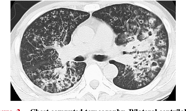

a ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct ct
 Chest computed tomography Bilateral centrilobular particulate opacity and cavities with pleura effusion in the right lung


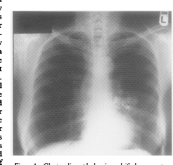

the chest is shown with the chest and chest
 Chest radiograph showing calcified masses at the left hilum and left mid zone


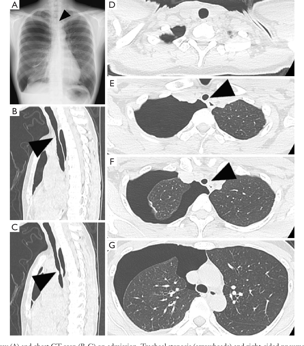

the chest and chest are shown in this image
 Chest Xray  and chest CT scan BG on admission Tracheal stenosis arrowheads and rightsided pneumothorax can be seen


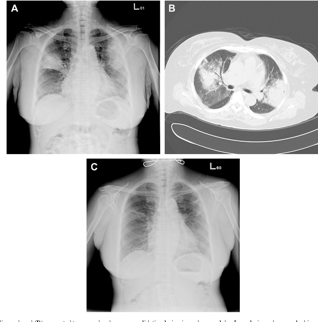

the left side of the chest shows the left side of the chest and the right side of the chest
  Chest radiograph and  computed tomography show a consolidation le discontinuation of sirolimus and an increase in the dose of corticosteroid 


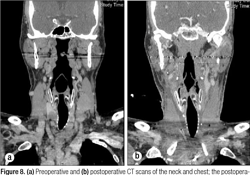

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 a Preoperative and b postoperative CT scans of the neck and chest the postoperative scan shows removal of the xmarked node


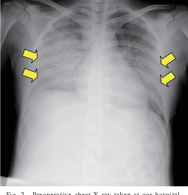

a chest with a yellow arrow pointing up to the chest
 Preoperative chest Xray taken at our hospital Groundglass opacities and pleural effusion are depicted in the bilateral middle lower lung fields


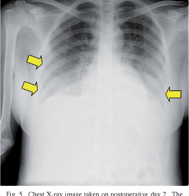

a chest with a yellow arrow pointing to the chest
 Chest Xray image taken on postoperative day 2 The shadows in the middle lung fields is starting to resolve


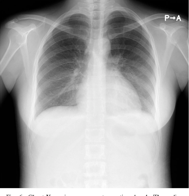

a chest with a large, open chest
 Chest Xray image on postoperative day 4 The radiolucency in both of the lung fields is increased


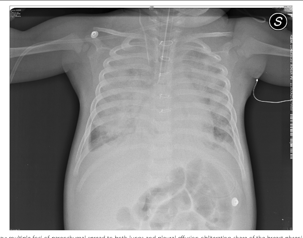

a chest with a radiograph showing the radiograph of the chest
 Chest XRay multiple foci of parenchymal spread to both lungs and pleural effusion obliterating share of the breastphrenic cost


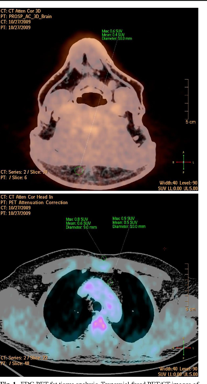

the image shows the location of the earth's orbit
 FDG PET fat tissue analysis Transaxial fused PETCT images of the neck upper and the chest lower regions in the same patient The CT window was set to the Hounsfield unit value range of fat tissue −70 to −110 HU in order to guide the appropriate placement of the fat tissue ROIs green ROIs are drawn in the subcutaneous fat tissue in the neck NeckSub upper and in the presternal region ChestSub lower ROIs were also placed in the pericardial fat tissue ChestPeri lower SUVmax SUVmean and the diameter of the ROIs are given


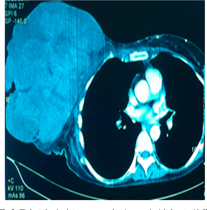

the ct scan is shown in the middle of the ct scan
 CT chest showing heterogeneous enhancing mass in right breast with illdefined deep margin


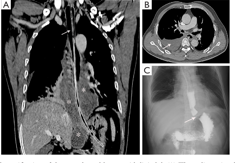

the left side of the chest shows the left side of the chest and the right side of the chest
 Chest CT scan and opacification of the oesophageal lumen with lipiodol  Three dimensional reconstructive CT scan showed that the gastric tube was inserted arrow and a large oesophageal mass asterisk which involved the gastroesophageal junction  pleural effusion arrow in the right chest  oesophageal stricture at the gastroesophageal junction arrow without contrast extravasation CT computed tomography


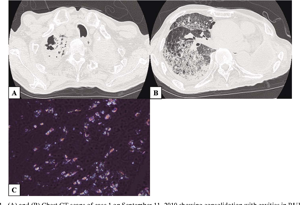

the left side of the brain shows the left side of the brain and the right side of the brain
  and  Chest CT scans of case 1 on September 11 2010 showing consolidation with cavities in RUL and ground glass opacity in RML and RLL  Polarized light examination of a tissue section revealed abundant deposition of birefringent crystals partial polarization hematoxylin and eosin stain original magnification ×400 RUL right upper lobe RML right middle lobe RLL right lower lobe


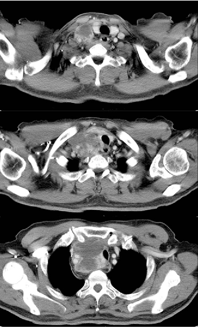

ct scan of the left knee
 Contrastenhanced chest CT images show a large mass involving the superior mediastinum extending to the right lower neck The mass contains a central necrotic portion and enhancing lesions in the mass periphery


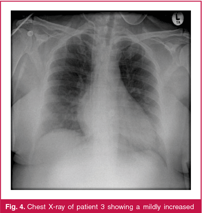

figure 4 chest x - ray of patient showing a diclusion
 Chest Xray of patient 3 showing a mildly increased cardiothoracic ratio and clear lung fields


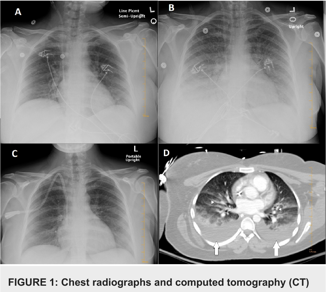

figure 1 chest radiographs
FIGURE 1 Chest radiographs and computed tomography CT


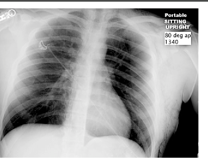

the chest is shown with a large rib bone
 Chest Xray at discharge hospital day 8


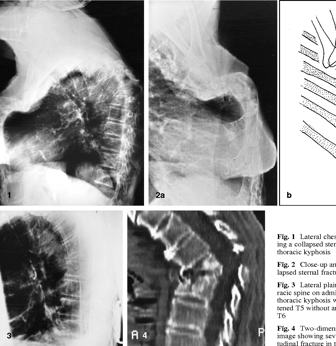

the left side of the chest shows the left side of the chest, and the right side shows the right
 Lateral chest plain radiograph showing a collapsed sternal fracture and severe thoracic kyphosis


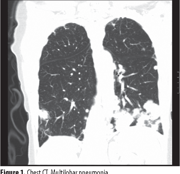

the lungs are shown in this image, and the lungs are shown in the image
 Chest CT Multilobar pneumonia


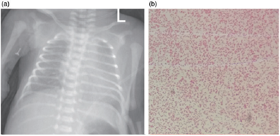

a photo of a bone fracture and a picture of a bone fracture
 a Chest Xray showing bilateral decreased translucency and a visible bronchus which suggests neonatal respiratory distress syndrome b Bacterial culture indicated that the baby was positive for Brucella species Three days after seeding Gramnegative coccobacilli were detected


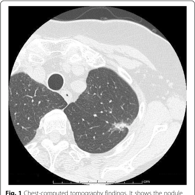

a ct scan with a large, flat, flat, flat, flat, flat, flat, flat, flat, flat, flat, flat
 Chestcomputed tomography findings It shows the nodule of left S12 with indentation It is 22 mm in size


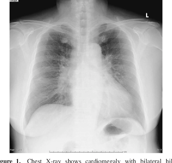

chest x - ray x - ray, x - ray, x - ray, x - ray, x - ray, x - ray, x ray, x - ray, x - ray, x - ray, x - ray, x -
 Chest Xray shows cardiomegaly with bilateral hilar lymphadenopathy


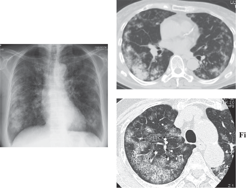

the chest and chest are shown in this image
 a Chest radiograph on admission showed bilateral consolidation and reticular shadow b c Computed tomographic CT scan of chest on admission showed multiple areas of consolidation groundgrass shadows and thickening of peribronchovascular interstitium


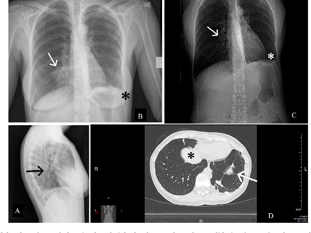

the chest and chest are shown in this image
 – Xray of the chest    showing basalright focal parenchymal consolidation arrows and costophrenic angle obliteration white  HRCT  showing paracardiac groundglass nodular lesion black  and nodular groundglass opacity in the basal segment of the left lung arrow


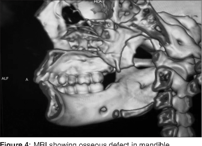

a mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest Xray No signs of pulmonary TB  MRI showing osseous defect in mandible


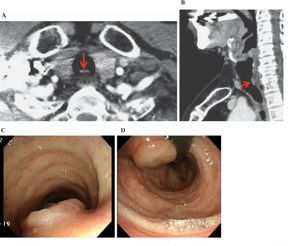

the left side of the left ear shows the different areas of the left ear
   Chest CT showing intraluminal tumor arrow in the upper trachea    bronchoscopic examination showing the nonpigmented flat tumor in the upper trachea


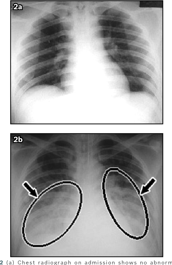

the chest and chest are shown in this image
 a Chest radiograph on admission shows no abnormality b Chest radiograph obtained 72 hours later shows confluent airspace opacities consistent with pulmonary oedema circles and arrows


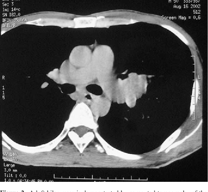

the ct scan is a small, flat, bone with a small, flat, flat, bone
  left hilar mass is demonstrated by computed tomography of the chest August 2002


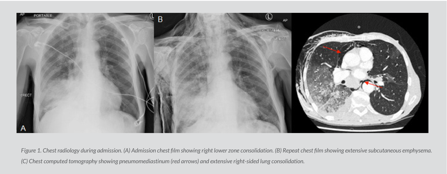

a radiograph of the chest and chest with a radiograph of the chest
 Chest radiology during admission  Admission chest film showing right lower zone consolidation  Repeat chest film showing extensive subcutaneous emphysema  Chest computed tomography showing pneumomediastinum red arrows and extensive rightsided lung consolidation


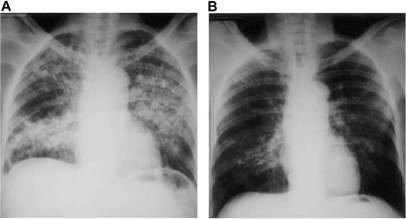

a chest with a large, open chest and a small chest with a large, open chest
  Chest radiograph at diagnosis showing severe mixedtype infiltrative lesions in a 65yearold patient with paracoccidioidomycosis  Radiograph for the same patient at the end of the posttherapy followup period 12 months showing extensive fibrosis and basal bullae


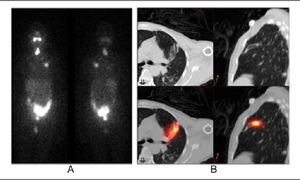

the left side of the left side shows the different areas of the left side of the left side, and
 Cryptic uptake in the chest corresponding to bronchiectasis on SPECTCT  56yearold woman with a history of PTC treated with surgery and then 100 mCi of I131 Posttherapy WBS 4A demonstrates focal activity in the lungs On SPECTCT 4B this area was diagnosed as bronchiectasis Abbreviations WBS whole body scan SPECTCT singlephoton emission computed tomography


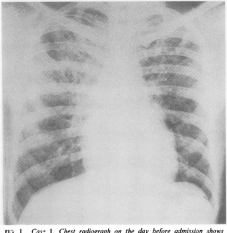

a chest with a large rib and a small rib
FIG 1 Cas 1 Chest radiograph extensive opacities in both lungs on the day before admission shows


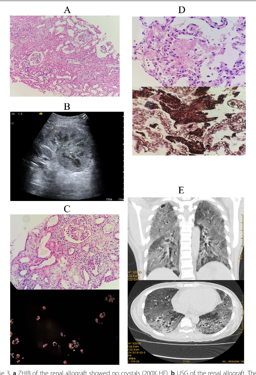

a col col of multiple thyroid cells in the liver
 Clinical data of Case 3 a ZHIB of the renal allograft showed no crystals 200X HE b USG of the renal allograft The renal volume was increased obviously than normal c Renal transplant biopsy on postop day 75 documented acute TCMR 2015 Banff 2A and extensive deposits of CaOx crystals in the interstitial tubule 200X HE and polarized light d Pneumocystis jirovecii pneumonia PJP was confirmed in the patient on May 25 2016 by fiberoptic bronchoscopic FOB biopsy which showed Pneumocystis organisms 600X HE and Methylamine silver e Chest CT examination demonstrated diffuse groundglass opacities GGO


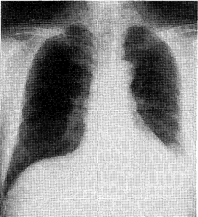

a black and white image of a lungs
 Chest Xray examination on admission


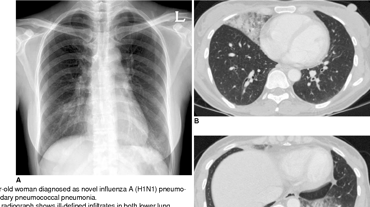

the chest and chest are shown in this image
 42yearold woman diagnosed as novel influenza  H1N1 pneumonia with secondary pneumococcal pneumonia  Initial chest radiograph shows illdefined infiltrates in both lower lung zones   Chest CT scans show lobardistributed illdefined consolidation and peripheral groundglass opacities in right middle lobe and left lower lobe


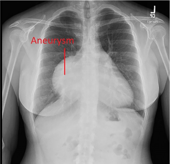

chest xrays with aneurm
FIGURE 1 Preoperative chest radiograph demonstrating a large mass silhouetting the right border of the heart


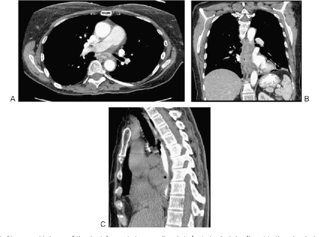

the ct scan shows the location of the ct scan in the left side of the ct scan
 Computed tomographic image of the chest demonstrates a small pocket of extraluminal air adjacent to the subcarinal esophagus with esophageal narrowing and thickening  axial  coronal and  sagittal


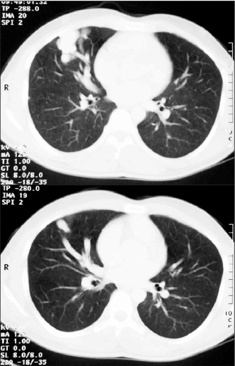

ct scan of the brain
a 2b Contrastenhanced chest CT scans demonstrating a lobulated enhancing subpleural mass with feeding artery and draining vein


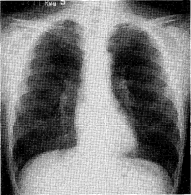

a black and white image of a lungs
 The shadow was suspected to be a lung abscess on the finding of chest Xray on July 28 1997


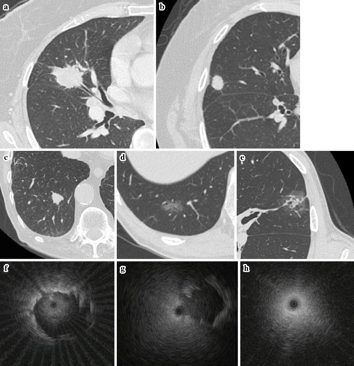

the left side of the ctt shows the different areas of the ctt
 a  chest CT image revealing a bronchus leading directly to a PPL CT bronchus signpositive b  chest CT image revealing a bronchus that does not lead directly to a PPL CT bronchus signnegative ce We divided PPLs into the following three groups according to their structures solid nodule c pure GGN d and partsolid nodule e f The EBUS probe is located within a PPL g The EBUS probe is located adjacent to a PPL h The EBUS probe is located outside a PPL


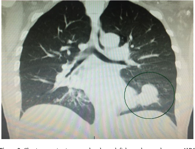

a ct scan with a ct scan
 Chest computer tomography shows left lower lung pulmonary AVM black circle


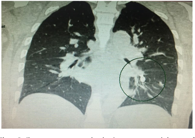

a photo of a lung with a green circle
 Chest computer tomography showing status postembolectomy of pulmonary AVM black circle


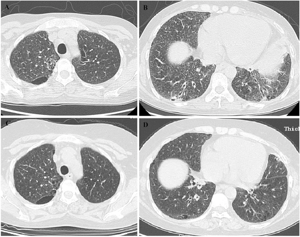

the left side of the brain shows the different areas of the brain
 Case 2 AB Chest CT Jun 23 2011 showed centrilobular nodules patchy consolidation and GGOs subpleural cysts and bronchiolectasis in both lower lobes CD Chest HRCT Apr 18 2012 demonstrated that centrilobular nodules patchy consolidation and GGOs were all absorbed and the changes of imaging were better than ten months before


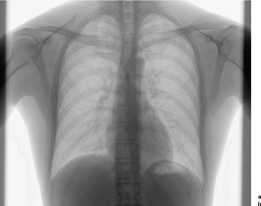

the chest is shown in this image
 Enhanced chest Xray image using adaptive unsharp masking


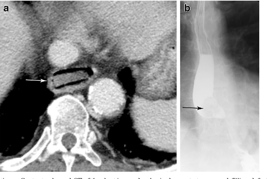

the left side of the chest shows the left side of the chest and the right side of the chest
 Foreign body impaction a Contrastenhanced CT of the chest in soft tissue window shows a squareshaped opacity piece of carrot impacted within the thoracic oesophagus just above the level of the diaphragm b Esophagram in AP projection in another patient with dysphagia demonstrates a round filling defect within the midthoracic oesophagus This was endoscopically confirmed to be an impacted hot dog


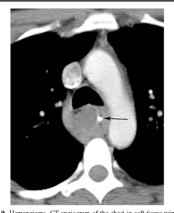

a mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Hemangioma CT angiogram of the chest in soft tissue window shows a round calcification within the wall of the oesophagus compatible with a phlebolith This finding is most often seen in patients with varices however this patient was found to have a hemangioma


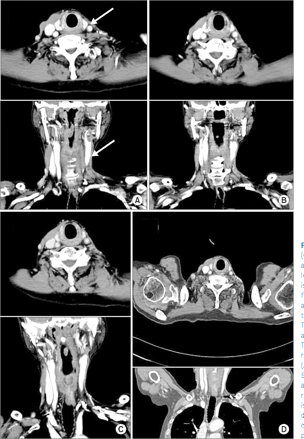

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Serial computed tomography CT images of the patient on coronal and axial imaging Atrophy of the left sternocleidomastoid muscle is prominent in the left irradiated field white arrow The patient has a marked decrease in fat beneath the left sternocleidomastoid muscle This resulted in the muscle directly abutting the paraspinal muscles The left internal jugular vein was removed during neck dissection  Two years and 11 months  5 years and 1 month  7 years and  9 years and 2 months after radiotherapy The CT image of  is a little different from the others due to the chest CT image The chest CT was performed to evaluate pulmonary metastasis


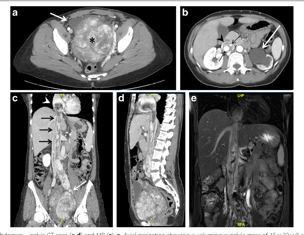

ct scan and ct scan
 Chest – abdomen – pelvis CT scan ad and MR e a Axial projection showing a voluminous pelvic mass of 15 × 22 × 9 cm asterisk with significant contrast enhancement due to hypervascularization causing right anterolateral dislocation of the bladder arrow b The mass also determines left hydroureteronephrosis white arrow Notice the presence of contrastenhanced large vessels black arrows within the IVC arrowhead cd Coronal and sagittal CT projections showing the pelvic tumor directly extending into the left iliac vein white arrow IVC black arrows and occupying the right atrium arrowhead e Coronal MR projection showing the caval and cardiac extension of the tumor


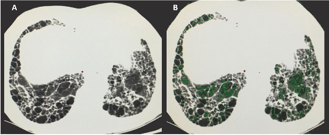

a sample of the tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor tumor
 Expiratory CT from a subject with IPF associated with air trapping Images from an 83yearold patient diagnosed with IPF  Axial chest CT scan demonstrates extensive areas of honeycombing in the cortical of the inferior lobes suggestive of UIP pattern  Same CT slice demonstrating the air trapping regions colored in green ATIexp  316 EIratio  091


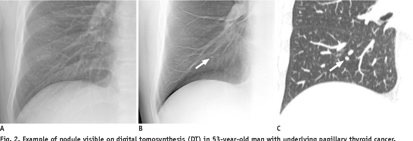

a radiograph of the left arm and the right arm
 Example of nodule visible on digital tomosynthesis DT in 53yearold man with underlying papillary thyroid cancer  Chest Xray shows no definite nodule in right lower lung field  DT depicts tiny nodule arrow in right lower lung field  Coronal reconstructed chest computed tomography image reveals 3 mm nodule arrow in right lower lobe which was confirmed to be lung metastasis Among six readers four did not detect this nodule whereas two readers recognized nodule


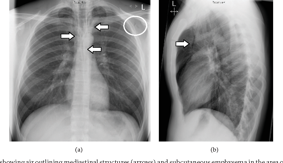

a chest with a small fracture and a small fracture
 Chest Xray showing air outliningmediastinal structures arrows and subcutaneous emphysema in the area of the left axilla circle


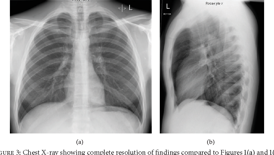

chest x - ray showing resct of chest and lung
 Chest Xray showing complete resolution of findings compared to a and 1b


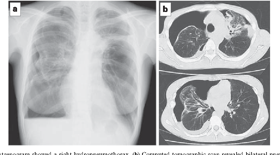

the chest and chest are shown in this image
 a Chest roentgenogram showed a right hydropneumothorax b Computed tomographic scan revealed bilateral pneumothorax


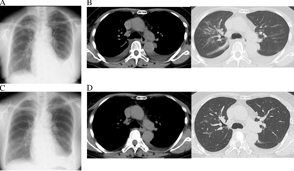

the left side of the chest shows the different areas of the chest
   chest radiograph reveals diffuse ground glass opacity in the right lung fields and leftsided effusion  Chest computed tomography images at the tracheal carina level show ground glass opacity in the right lung fields and bilateral pleural effusion    chest radiograph and chest computed tomography images after steroid therapy Bilateral pleural effusion and ground glass opacity are decreased


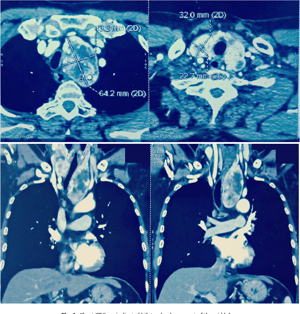

a series of images showing the different areas of the human body
 Chest CT Scan indicated b


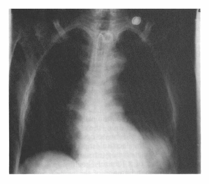

a chest xray with a large, open chest
 Chest radiograph showing a hazy left hemi diaphragm


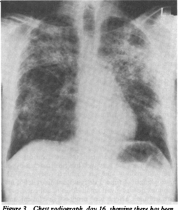

a chest with a large, open chest
 Chest radiograph day 16 showing there has been no improvement


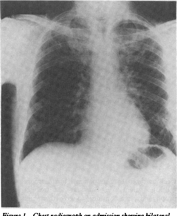

a chest with a chest with a chest radiograph
Figure  Chest radiograph on admission showing bilateral upper zone shadowing the mid and lower zones are relatively clear


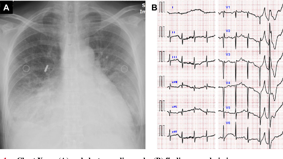

a chest with a normal chest and a normal chest with a normal chest
 Chest Xray  and electrocardiography  findings on admission


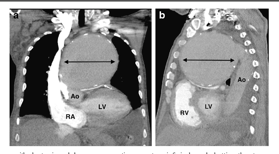

the left side of the chest shows the left side of the chest and the right side of the chest shows
  70yearoldman with chest pain and dyspnoea on exertion underwent a CT pulmonary angiogram CTPA for suspected pulmonary embolus a Coronal and b sagittal MPRs from the CTPA demonstrate a large fusiform peripherally calcified aneurysm double arrow of the ascending aorta Ao causing severe compression of the main pulmonary


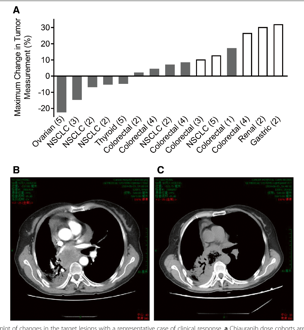

the ctt and ctt mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Waterfall plot of changes in the target lesions with a representative case of clinical response a Chiauranib dose cohorts are shown in parentheses as 1  10 mg 2  20mg 3  35 mg 4  50mg and 5  65 mg Open bars represent patients who had progressive disease and the filled bars represent patients who achieved stable disease as their best responses Not shown n  3 due to unavailable tumor measurements Coronal chest CT at baseline b and after 4 weeks chiauranib treatment c from a 59yearold woman with poorly differentiated adenocarcinoma of the lung who has been received surgery adjuvant chemotherapy chemoradiation and two salvage chemotherapies


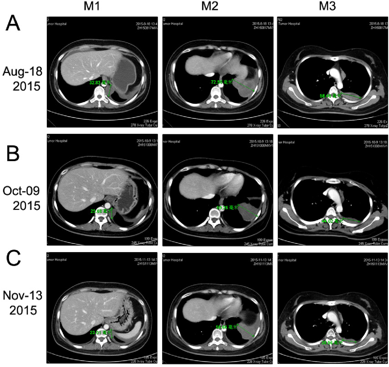

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest CT scan documenting responses to Sunitinib  After 4 weeks of treatment with Sunitinib 50 mgday CT image showing a SD 1412 Aug 18 2015  After about three months of treatment with Sunitinib CT image showing a PR 3241 Oct 09 2015  After continuous treatment with Sunitinib for about four months CT image showing a confirmed PR 3678 Nov 13 2015


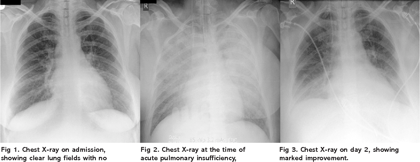

a chest xray with a large, open chest
 Chest Xray on admission  Chest Xray at the time of  Chest Xray on day 2 showing showing clear lung fields with no acute pulmonary insufficiency marked improvement cardiomegaly showing bilateral extensive diffuse


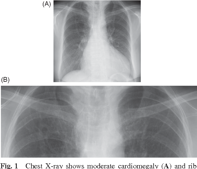

the chest and chest are shown in this image
 Chest Xray shows moderate cardiomegaly  and rib notching 


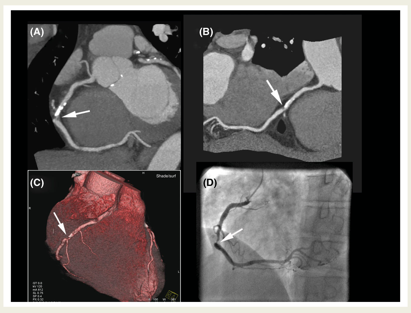

the left side of the left side of the left side of the left side of the left side of the
 Coronary artery stenosis detection with multidetector row computed tomography Highgrade stenosis of the midright coronary artery in a 55yearold man with atypical chest pain   maximum intensity projection with a highgrade luminal reduction distal to a calcified segment   curved multiplanar reconstruction   threedimensional rendering of the heart and right coronary artery  shows the corresponding coronary angiogram


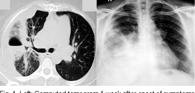

the chest and chest are shown in this image
 Left Computed tomogram 1 week after onset of symptoms shows a rightmiddle lobe lung abscess with an airfluid level and small ipsilateral pleural effusion Right Chest radiograph 2 weeks after the onset of symptoms shows a thinwalled irregular rightmidzone lung abscess without no airfluid level


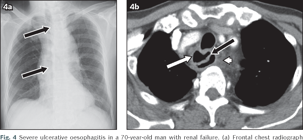

a chest with a radiograph showing the radiograph of the chest and the radiograph of the chest
 Severe ulcerative oesophagitis in a 70yearold man with renal failure a Frontal chest radiograph shows vertical linear lucency black arrows in the midline representing the dilated oesophagus b Axial CT image of the upper oesophagus shows diffuse thickening of the oesophageal wall white arrow and an overhanging mucosa black arrow creating a ‘double lumen’ which is associated with fat stranding in the mediastinum white arrowhead


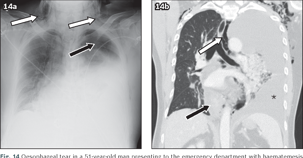

a radiograph of the chest and chest with a small fracture
 Oesophageal tear in a 51yearold man presenting to the emergency department with haematemesis preceded by retching a Frontal chest radiograph shows a large left pleural effusion left pneumothorax black arrow and chest wall emphysema white arrows b Coronal CT image shows a thickened lower oesophagus due to haematoma black arrow a large left pleural effusion  and pneumomediastinum white arrow


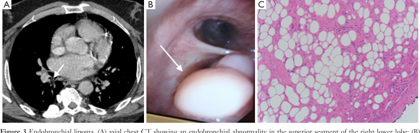

a ct scan and ct scan in a patient's stomach
 Endobronchial lipoma  axial chest CT showing an endobronchial abnormality in the superior segment of the right lower lobe  bronchoscopic image of the large endobronchial soft polypoid lesion originating from the superior segment of the right lower lobe  microscopic image of an airway lipoma The image shows airway epithelium on the right lower corner and submucosal tissue replaced by benign adipocytes Hematoxylin and Eosin stain 200×


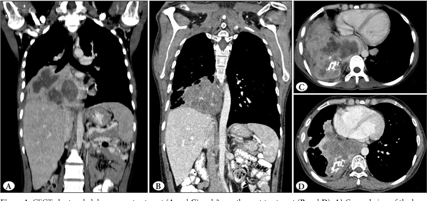

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 CECT chest and abdomen pretreatment  and  and 3 months post treatment  and   Coronal view of the large heterogeneously enhancing lesion which involved the right middle and lower lobe of the lung impinging on the superoposterior surface of the liver  Axial view of the large mass involving the right middle and lower lobe of the lung with coarse calcification involving the mediastinal pleura and pericardium and extending into the mediastinum BD Coronal and axial view showing reduction in the size of the tumor


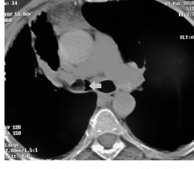

the ct scan shows the location of the ct scan in the skull
 CT of the chest showing an endobronchial tumor with low attenuation suggesting a fat containing lesion


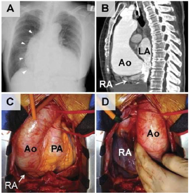

a photo of the left side of the chest, with the left side of the chest and the right side
  Chest roentgenogram in the posterior–anterior view reveals pronounced cardiomegaly with marked projection of the right mediastinal border arrowheads  Sagittal view of contrastenhanced 64 slice computed tomography shows the enlarged aortic root Ao which is posteriorly expanded with compression of the atrial chambers and their septum  In the intraoperative views obtained after sternotomy the enlarged and elongated aortic root nearly reaches the diaphragm and  manual lifting of the ascending aorta exposes the posteriorly compressed right atrium RA LA  left atrium PA  pulmonary artery


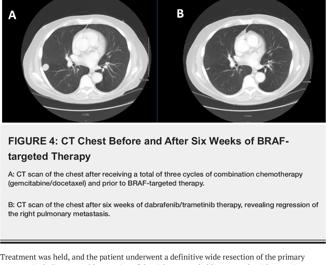

the ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt ctt
FIGURE 4 CT Chest Before and After Six Weeks of BRAF


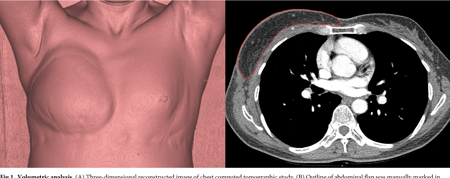

a ct scan with a ct scan and ct scan
 Volumetric analysis  Threedimensional reconstructed image of chest computed tomographic study  Outline of abdominal flap was manually marked in each scan image


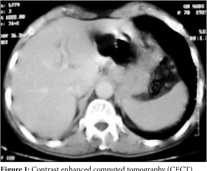

figure 1 concopte comoraby cf
 Contrast enhanced computed tomography CECT chest showing a well defined rounded cavitatory mass lesion in right lower lobe with enhancement of wall and air fluid level seen with eccentric calcification


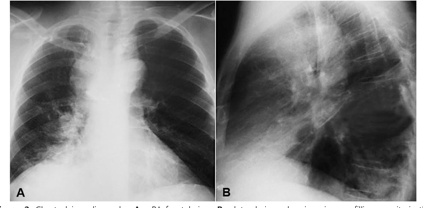

a chest radiograph showing the chest and chest
 Chest plain radiography  – PA frontal view  – lateral view showing airspace filling opacity in the middle and inferior lobes as well as anterior mediastinum enlargement


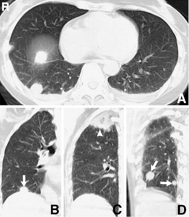

the left side of the chest shows the left side of the chest and the right side of the chest shows
 Axial  and coronal – chest computed tomography scans at the lung window at 4 months after the initial diagnosis of gliosarcoma  Two nodular masses in the right lung with bilateral pleural effusions – Multiple coin lesions arrows in the right lung with atelectasis of the upper lobe arrowhead


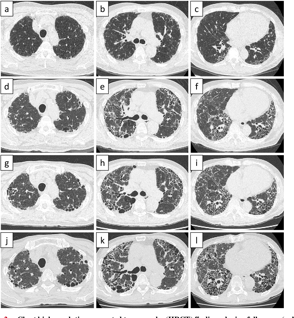

the brain is shown in this image, and shows the different areas of the brain
 Chest highresolution computed tomography HRCT findings during followup a b c Image at the initial presentation d e f Image before nintedanib administration g h i Image after stopping nintedanib j k l Image eight months after stopping nintedanib The honeycomb appearance gradually deteriorated but the findings were stable while using nintedanib


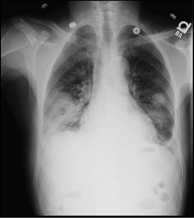

a chest with a radiograph showing the chest and lungs
 Chest radiograph


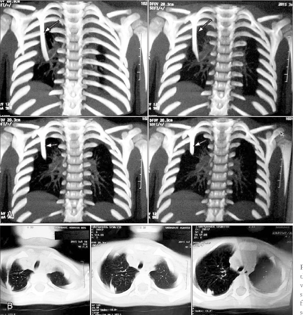

the chest and ribs are shown in this image
  3yearold boy with rare intratho racic rib coronal  and axial  view of chest computed tomography scan shows arising intrathoracic rib from the inferior border of the right second rib arrows


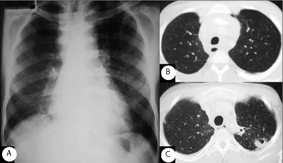

a chest with a small chest and a large chest with a small chest
 Chest radiograph shows a reticular pattern in the middle and lower regions of both lungs  Axial CT images lung window obtained at the level of the upper mediastinum show multiple micronodular opacity in the upper lobe  and illdefined cavities in the left upper lobe  on the first and second admission respectively


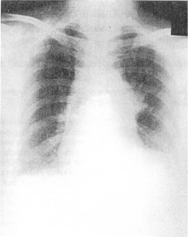

a black and white photo of a chest with a large rib
 Chest Xray upon admission demonstrating a mediastinal mass with an elevated left diaphragm 


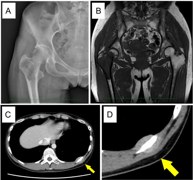

the left side of the mri shows the left side of the mri and the right side of the mri
 Clinical examination of a tumor from an LMS patient  Xray showing a radiolucent bone tumor in the trochanteric area of the right femur  Massive bone tumor in the right proximal femur observed as a lowintensity signal by T1weighted magnetic resonance imaging  Chest computed tomography CT showing a massive lesion in the left 10th rib arrow  An enlarged view of the chest CT image arrow


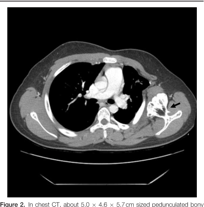

figure 2 in ctr, at 6 5 m, 7 m and unequald bony
 In chest CT about 50 46 57cm sized pedunculated bony lesion is noted in the ventral aspect of left scapula which shows the continuity of bony cortex and medulla


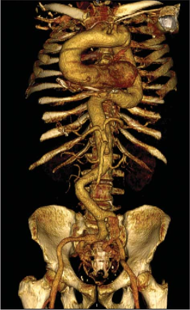

the bones of the spine
 Computed tomography angiography of the chest and abdomen demonstrated aneurysmal dilatation of the left main coronary artery aorta and bilateral iliac arteries


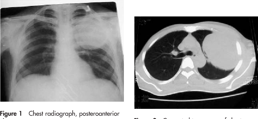

the chest and chest are shown in this image
 Chest radiograph posteroanterior view  Computed tomogram of chest


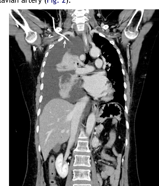

the ctd ctd ctd ctd ctd ctd ctd ctd ctd ctd
 Chest computed tomography scan shows the central venous catheter penetrating the right subclavian artery and within the pleural space white arrow The large amount of pleural effusion with a passive atelectasis of the right lung subsegmental atelectasis in the left lung and a left mediastinal shift are shown Left nephrectomy state and postoperative pneumoperitoneum can be seen


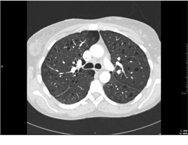

the brain is shown in this image
 Computerised axial tomography scan of the chest showing multiple welldefi ned thinwalled bilateral lung cysts consistent with lymphangioleiomyomatosis


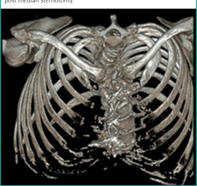

the skeleton of a human
 Preoperative threedimensional chest computed tomography


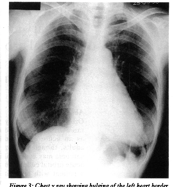

a chest with a chest and chest with a chest with a chest with a chest with a chest with a
 Chest x ray showing bulging ofthe left heart border due to enlargement ofthe left atrium


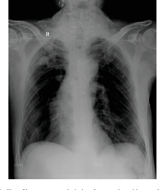

the chest is shown with a large, open chest
 Chest Xray scan on admission Increased markings and transmittance were observed in the lungs Dense nodule shadows was detected in bilateral upper lungs while the bilateral diaphragmatic muscle was low


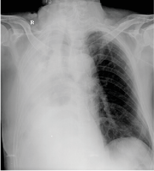

a chest x - ray with a small, white, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy, lumpy
 Bedside chest Xray scan conducted at 5 h after surgery The right thoracic cavity presented increased effusion and the mediastinum was broader compared with that observed on admission


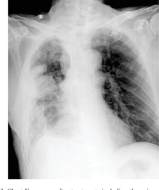

a chest with a radiograph showing the chest and chest
 Chest Xray scan after treatments including thoracic surgery and blood transfusion The right chest area presented encapsulated effusion and pleural adhesion  right


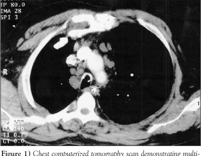

a ct scan with a ct scan in the middle of the ct scan
 Chest computerized tomography scan demonstrating multiple enlarged lymph nodes in the anterior mediastium the aortic pulmonary window and the pretracheal paratracheal and subcarinal regions as well as increased soft tissue adjacent to the right main stem bronchus and right lower lobe bronchus


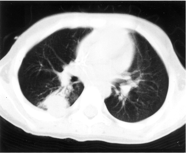

a ct scan of the chest
 CT scan of the chest 4 weeks after clinical symptoms resolved showing a nodular shadow in the right lower lobe


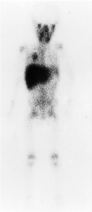

a black and white image of a black substance
 Gallium scintigraphy showing a round hot area in the right chest corresponding to the shadow seen in the CT scan in 


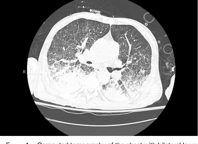

the ctd ctd ctd ctd ctd ctd ctd ctd ctd ctd
FIGURE 1 Computed tomography of the chest with bilateral lower lobe consolidation and edema


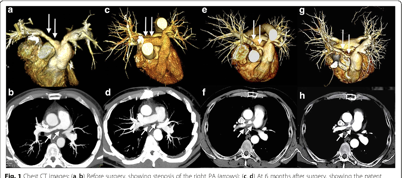

the left side of the heart shows the different stages of the heart
 Chest CT images a b Before surgery showing stenosis of the right PA arrows c d At 6 months after surgery showing the patent grafts of the right PA arrows e f At 18 months after surgery showing the stenosis of the right PA graft arrows g h At 34 months after surgery showing unchanged stenosis of the right PA graft arrows


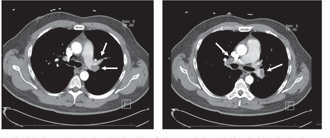

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 CT angiography of the chest was done showing multiple large bilateral pulmonary emboli extending from the right and main pulmonary arteries into the segmental and subsegmental branches with heavy clot burden bilaterally Arrows show areas of PE


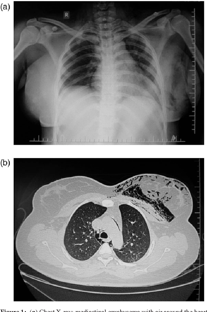

the chest and chest are shown in this image
 a Chest Xray mediastinal emphysema with air around the heart and subcutaneous emphysema seen in the chest wall and left breast b CT scan chest air around the aorta trachea and in the left breast Note the absence of pneumothorax


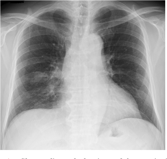

a chest with a large, open chest
 Chest radiograph showing nodular opacity in the right middle field


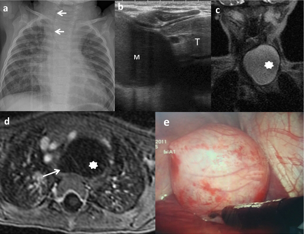

the left side of the chest shows the left side of the chest and the right side of the chest
  10monthold boy with a congenital cardiopathy presents respiratory distress a Chest Xray a left cervicothoracic mass is suspected displacing the trachea to the right arrows b Chest US cystic mass  with slightly echogenic content inside is seen next to the thymus  Its origin is unclear c Coronal view SSFSE T2 MRI a welldelineated and hyperintense lesion star is seen d Transversal view of the lesion in a gadoliniumenhanced VIBE MRI confirms the cystic nature of the mass star next to the anterior oesophageal wall arrow e Thoracoscopic findings a 6 × 4 cm lesion with close contact with the trachea originated from the muscular wall of the oesophagus


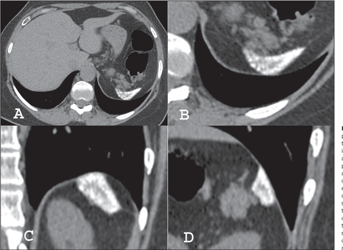

the ctd mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Computed tomography of the chest with mediastinal window settings  showing a decreased spleen size accompanied by diffuse small predominantly subcapsular and peripheral nodular calcifications some of them confluent with relative sparing of the central regions Detail of the splenic region axial computed tomography scan  with coronal and sagittal reconstructions  and  respectively showing the characteristics of the splenic calcifications in more detail


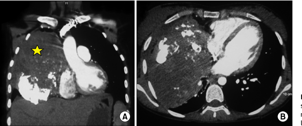

the left side of the mri shows the left side of the mri and the right side of the mri
 Chest computed tomography shows lage anterior medidastinal mass with calcification and collapsed right lung star


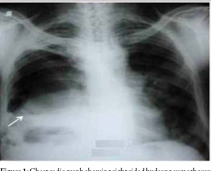

the chest is shown with a large, open chest
 Chest radiograph showing right sided hydropneumothorax without shift of mediastinum towards opposite side arrow


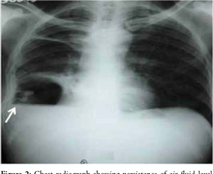

a chest with a small chest with a small chest with a small chest with a small chest with a small
 Chest radiograph showing persistence of air fluid level after tube thoracostomy arrow


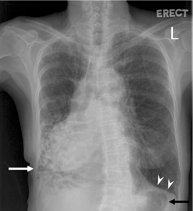

a chest with a small, open chest
 Chest radiograph showed bronchiectasis in the lower zones of both lungs more severe on the right side white arrow Both lungs were hyperinflated with flattening of the diaphragm arrowheads There was dextrocardia The gastric bubble was seen below the left hemidiaphragm black arrow


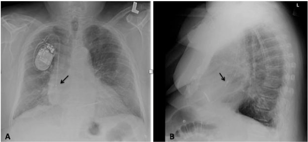

a chest with a small lump in the middle and a small lump in the middle
 Chest radiography PA and left lateral views showing retracted atrial lead arrow back into the superior vena cava and right atrium junction


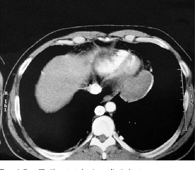

the ct scan shows the location of the ct scan in the brain
 Chest CT with contrast showing mediastinal cysts


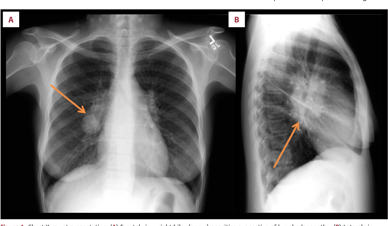

a chest with a small fracture and a large fracture
 Chest Xray at presentation  Frontal view right hilar arrow opacities suggestive of lymphadenopathy  Lateral view subcarinal arrow opacities suggestive of lymphadenopathy


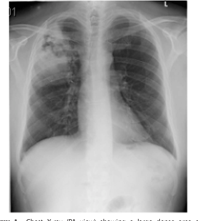

a chest with a chest with a chest with a chest with a chest with a chest with a chest with
 Chest Xray PA view showing a large dense area of parenchymal opacification in the posterior lateral segments of the right upper lobe There is a large irregular central cavitation with adjacent pleural thickening


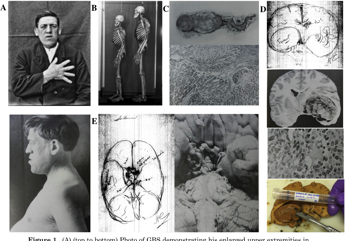

a col of images of human and animal anatomy
  top to bottom Photo of GBS demonstrating his enlarged upper extremities in relation to his chest Profile of patient GBS with clinical signs of growth hormone excess including prognathism and coarse facial features also evident are skin tags and freckling the latter we now realize as part of CNC 7  Skeleton of patient GBS left demonstrating enlarged thorax extremities and skull compared with another acromegalic patient from the same collection right 7  top to bottom Gross specimen of adrenal gland Scattered throughout are pigmented nodules consistent with PPNAD  histological slide demonstrates the intersection of four nodules 803 7  top to bottom Original sketch from Dr Cushing’s Brigham notes of the intracranial tumor 6 Gross specimen of the same pituitary adenoma extending into the right temporal lobe Histology showed large cells disposed in sheets 6003 7 Sampling of the same slice of archived brain tissue today at our laboratory  left to 

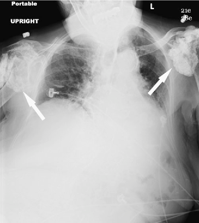

a chest with a large lump on the left side
 Chest radiograph demonstrating diffuse subcutaneous and muscular calcifications in the shoulders arrows


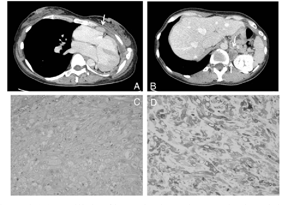

the left side of the mri shows the left side of the mri, and the right side shows the left
 Chest computed tomography CT scan and histology of the retroperitoneal tumor Chest CT scan showed tumors in the left anterior chest wall  and retroperitoneum  Resected retroperitoneal tumor consisted of a sheet of epithelioid cells with abundant eosinophilic cytoplasm hematoxylin and eosin stain  Tumor cells were positive for calretinin immunostaining   color version of this figure is available as supplementary data at http wwwjjcooxfordjournalsorg


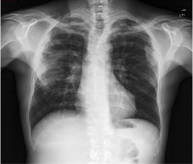

a chest with a large, open chest
 Chest xray bilateral pulmonary opacities


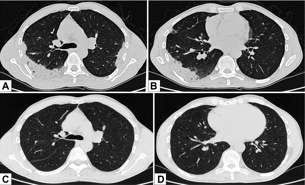

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest highresolution CT scan prepost oral corticosteroids OCS treatment  bilaterally areas of parenchymal thickening with plane bronchograms confluent located in the upper lobes bilaterally and peripherally in the posterolateral mantle area of the superolateral segment of the upper lobe  Areas of parenchymal thickening with plane bronchograms on the apical of the inferior right lobe   Resolution of parenchymal thickening after OCS therapy


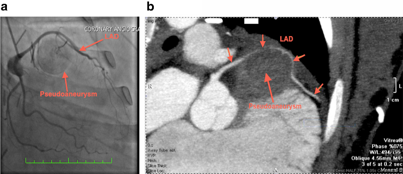

the left side of the mri shows the left side of the mri and the right side of the mri
 a Diagnostic coronary angiogram showing a large circular structure that fills via fistula from the midleft anterior descending consistent with a pseudoaneurysm b Chest CT angiogram with contrast demonstrating the 40×33 cm pseudoaneurysm in relation to the midleft anterior descending artery which did not opacify with contrast suggesting thrombosis The LAD was lifted superiorly off the surface of the myocardium with the pseudoaneurysm almost encasing the LAD and a large component seen along the inferior aspect of the narrowed artery extending for 32 cm indicated by arrowheads


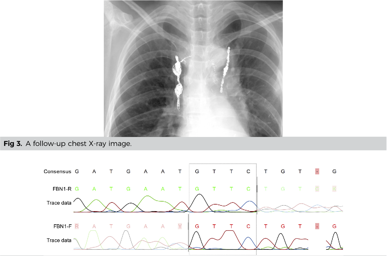

figure 3 - figure 3 - figure 3 - figure 5 - figure 5 - figure 5 - figure 5 - figure 5 - figure 5 - figure
  followup chest Xray image


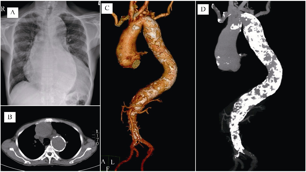

the left side of the left side shows the left side of the left side of the left side of the
 Image examination of case 1  Chest Xray showing cardiomegaly and calcification of the descending thoracic and abdominal aorta  CT abdomen demonstrating the solar eclipse sign    3D CT reconstruction of the descending aorta showing extensive calcification extending from the proximal to the bifurcation Ascending aortic aneurysm can also be noted


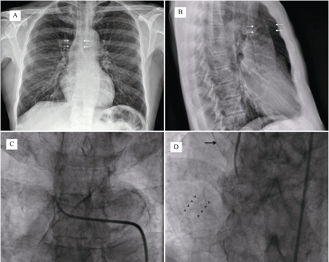

the chest and chest are shown in four different views
 Image examination of case 2  Chest Xray demonstrating calcific ascending aorta and arch of aorta white arrow  lateral chest Xray demonstrating the calcific ascending aorta white arrow    Angiogram with catheter in the arch of aorta demonstrating the calcific innominate artery black arrow and calcific coronary artery black arrow heads


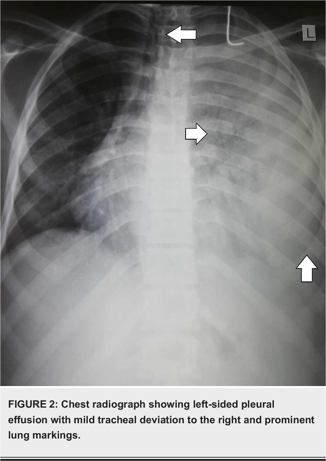

a chest with a large, open chest and a small chest with a large, open chest
FIGURE 2 Chest radiograph showing leftsided pleural


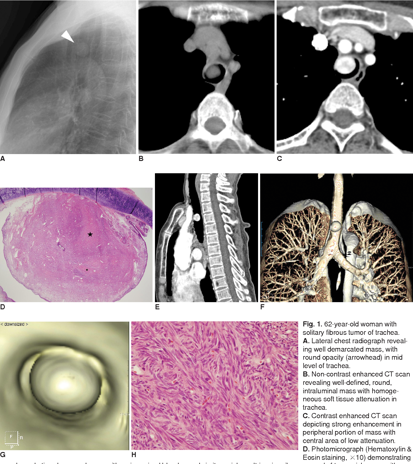

the left side of the chest shows the different areas of the chest and the right side of the chest
 62yearold woman with solitary fibrous tumor of trachea  Lateral chest radiograph revealing well demarcated mass with round opacity arrowhead in mid level of trachea  Noncontrast enhanced CT scan revealing welldefined round intraluminal mass with homogeneous soft tissue attenuation in trachea  Contrast enhanced CT scan depicting strong enhancement in peripheral portion of mass with central area of low attenuation  Photomicrograph Hematoxylin 


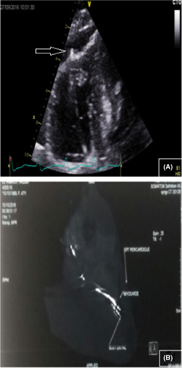

a ultrasound scan and a ct scan
  Zoom of right ventricle in the apical fourchamber view lead tip visualized in the pericardial space confirming perforation arrow  Chest computed tomography showing a myocardial perforation by the pacing lead arrow Note the associated pericardial effusion arrow


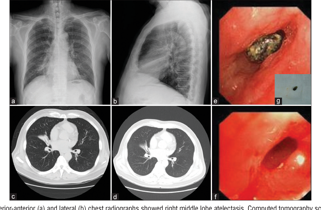

a series of images showing the different stages of the breast
 Posterior‑anterior a and lateral b chest radiographs showed right middle lobe atelectasis Computed tomography scan of the chest showed high‑density lesions in bronchi of the right middle lobe with right middle lobe atelectasis c Computed tomography scan of the chest showed right middle lobe atelectasis 1‑month after discharge d Bronchoscopic images showed the views of bronchi of the right middle lobe with foreign body e and dislodgment of the foreign body f The foreign body was identified as a grape seed g


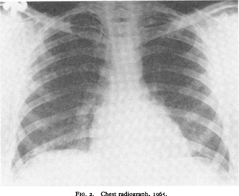

chest x - ray - chest x - ray - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x - chest x -
FIG 2 Chest radiograph I965


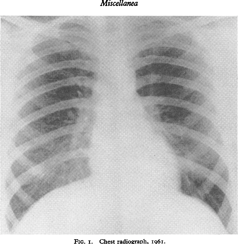

the chest and chest are shown in this image
FIG  Chest radiograph I96I


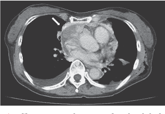

the ctd ctd ctd ctd ctd ctd ctd ctd ctd ctd
 Chest computed tomography after left thoracic drainage demonstrated pericardial and pleural effusion and a lesion with irregular heterogeneous density and illdefined margins arrow in front of the right atrium


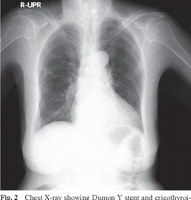

a chest x - ray showing the chest and chest
 Chest Xray showing Dumon  stent and cricothyroidectomy placed in the appropriate position of the injury of the trachea and carina


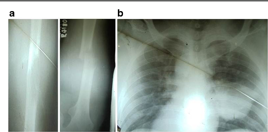

the radiology of the chest
 a Xray femur pathological fracture b Xray chest—secondary metastasis


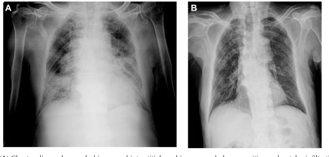

a chest radiograph showing the chest and chest
  Chest radiograph revealed increased interstitial marking groundglass opacities and patchy infiltration of the both lungs obtained at our emergency department  Chest radiograph revealed resolutions of these increased interstitial marking and groundglass opacities of the both lungs obtained 3 months after admission


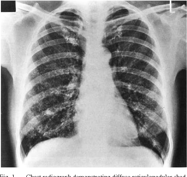

the chest is shown with a large, open chest
 – Chest radiograph demonstrating diffuse reticulonodular shadows and fine stippled appearance in the middle and lower lungs


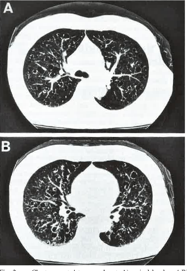

the left side of the brain shows the location of the left and right hemispheres
 – Chest computed tomography at  carinal level and  lower lobe Multiple cysts are located mainly over the hilar and central zone and high density areas are seen around the cysts


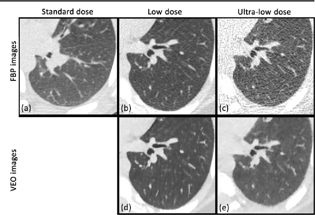

the brain and its structures
 At reduced dose and minimum dose the conspicuity of large structures like the central bronchi is slightly higher with VEO while for small structures like the subpleural vessels and lung fissures the visibility was higher with VEO in comparison to filtered backprojection FBP a Axial chest CT in a 10yearold boy included in group  standard protocol CTDIvol 0 199 mGy b–e Axial chest CT in an 8yearold boy included in group  reduced dose protocol CTDIvol 0 073 mGy minimum dose protocol CTDIvol 0 014 mGy


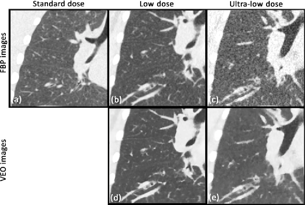

the left side of the chest shows the different areas of the left side
 At reduced dose and minimum dose the conspicuity of large structures like the central bronchi was higher with VEO For small structures like the subpleural vessels and lung fissures the visibility was strongly enhanced thus higher with VEO in comparison to FBP where some structures were not discernable a Coronal chest CT in a 10yearold boy included in group  b–e Coronal chest CT in an 8yearold boy included in group  same patients and acquisition as in 


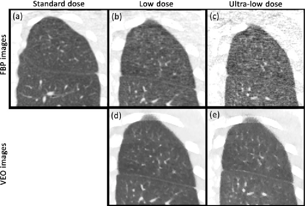

the four different types of the human brain
 At low dose and ultralow dose the visibility of small structures subpleural vessels and lung fissures was strongly enhanced with VEO in comparison to FBP With this latter reconstruction some structures were even not discernable a Coronal chest CT in an 11yearold girl included in group  standard protocol CTDIvol 0 136 mGy b–e Coronal chest CT in a 12yearold boy included in group  reduceddose protocol CTDIvol 0 043 mGy ULD protocol CTDIvol 0 014 mGy


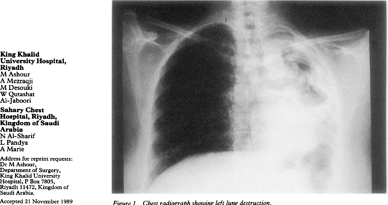

a black and white image of a chest with a large, open chest
Figure  Chest radiograph showing left lung destruction


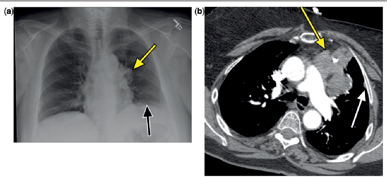

the left side of the chest shows the left side of the chest and the right side of the chest
  67yearold woman Chest radiograph a showed a lobulated anterior mediastinal mass yellow arrow with mild elevation of the left hemidiaphragm black arrow CT scan b demonstrated a lobulated leftsided anterior mediastinal mass yellow arrow and a 1cm leftsided pleural nodule white arrow


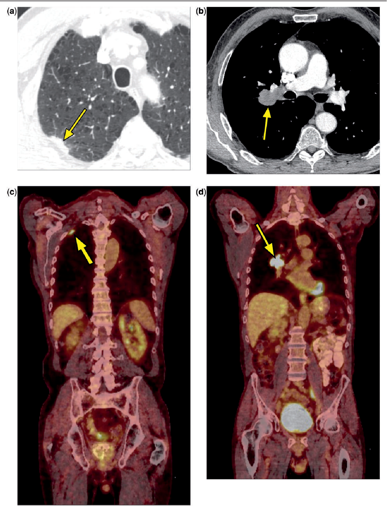

the left side of the mri shows the left side of the mri and the right side of the mri
  74yearold man Chest CT showed a 26cm diameter irregular nodular opacity along the pleural surface of the right upper lobe a arrow and a separate 4cm diameter right upper lobe perihilar mass b arrow Both lesions showed intense FDG avidity at PET scanning cd arrows


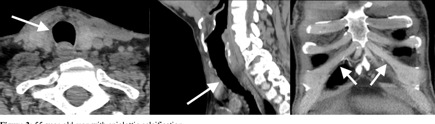

the left side of the mri shows the fracture of the left side of the mri
 55yearold man with epiglottic calcification Findings Axial noncontrast CT of the neck  with sagittal reformatted neck images  show no evidence of calcification in trachea Coronal reformatted images of chest  show no evidence of calcification of chondral cartilage or costochondral junction Techniques Axial noncontrast CT of the neck obtained on a 64slice CT scanner with sagittal reformatted images mA  75 kVP  120 Slice thickness  25 mm Coronal reformatted noncontrast CT of the chest obtained on a 64slice CT scanner mA  705 kVP  120 Slice thickness  07 mm


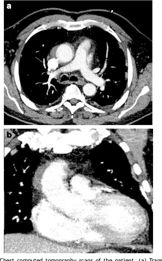

the ct mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest computed tomography scans of the patient a Transversal slice b vertical slice


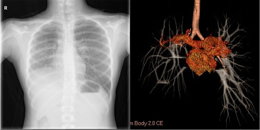

a chest with a large, open lung and a small lung
 Left panel The chest radiograph shows a shift of the mediastinal structures to the right side with elevation of the right hemidiaphragm Right panel Threedimensional image reconstruction shows the right hyparterial bronchus and the absence of the right upper lobe bronchi


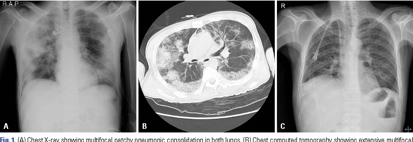

the left side of the chest shows the left side of the chest and the right side of the chest
  Chest Xray showing multifocal patchy pneumonic consolidation in both lungs  Chest computed tomography showing extensive multifocal ground glass opacities accompanying consolidation suggestive of pneumonia with acute respiratory distress syndrome  Chest Xray shows regression of pneumonic consolidation on the 9th day of admission


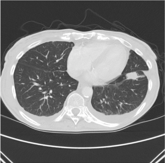

the ctd mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
 Chest CT scan showing a metastatic mass into the left lung


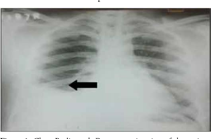

the chest is shown with a small black arrow
 Chest Radiograph Posteroanterior view of the patient showing blunt right costophrenic angle with elevated right hemidiaphragm


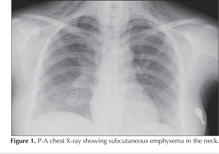

figure 1 chest x - ray showing cutaneous in neck
 PA chest Xray showing subcutaneous emphysema in the neck


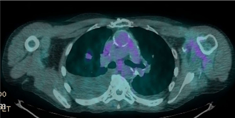

a ct scan shows the location of the ct scan in the brain
 Neuroendocrine tumor Positron emission tomographycomputerized tomography chest scan showing moderately 218FfluorodeoxyDglucose avid nodule of the right upper lobe


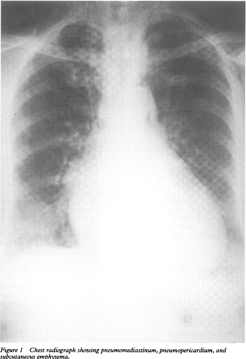

a chest with a large, open lung
 Chest radiograph showing pneumomediastinum pneumopericardium and subcutaneous emphysema


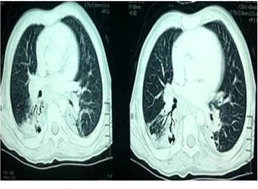

the brain is a large area of the brain that is not visible
 – Chest computed tomography


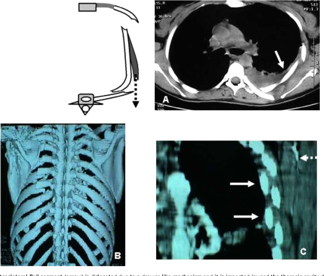

the axial bone is a bone bone bone bone bone bone bone bone bone bone bone bone bone bone bone bone
  The posterolateral flail segment arrow is dislocated due to a drawerlik osteomuscular covering  Tridimensional CTchest reconstruction showing the pos under scapula  Coronal view of a posterolateral flail segment The final result is int wall Arrows flail segment dotted arrow scapula osteomuscular splitting


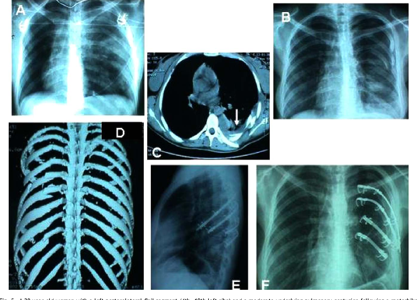

the chest is shown in this image, and the chest is shown in the image
  28yearold woman with a left posterolateral flail segment 4th—10th left accident The patient was handled conservatively without thoracic drainage Six wee symptoms  Chest Xray at admission note the absence of flail segment dislocatio reduction of the left hemithorax volume and retained left hemothorax  The CTslic scan reconstruction shows the final result the overriding and internally impacted ri patient underwent a secondary surgical fixation using slidingstaplestruts Only the ri 4th—7th Thereafter the patient became asymptomatic and returned uneventfully to


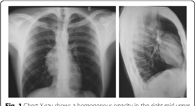

a chest with a radiograph showing the chest and chest
 Chest Xray shows a homogenous opacity in the right mid upper zone presenting no calcification


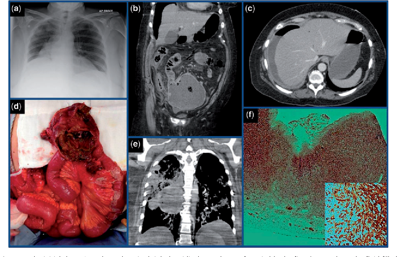

the left side of the chest shows the left side of the chest, and the right side shows the right
 The initial chest Xray showed a raised right hemidiaphragm but no free air a The first CT scan showed a fluidfilled diverticulum continuous with the small bowel b along with extraluminal air and fluid and portal venous air within the left lobe of the liver c The mucosal lining of the perforated diverticulum was necrotic and had a brown hue d The second CT scan extended into the chest and showed consolidation and a necrotic cystic lesion in the right lung e Histopathological assessment showed fullthickness infiltration of tumour across the bowel wall f staining for Melan  inset high magnification


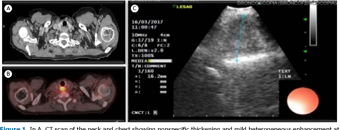

a ct scan is the most visible in the ct scan
 In  CT scan of the neck and chest showing nonspecific thickening and mild heterogeneous enhancement at the pharyngoesophageal junction In  positron emission tomography scan showing circumferential thickening of the cervical esophagus leading to narrowing of the esophageal lumen standardized uptake value 96 Note the absence of signs of invasion into the adjacent structures In  endobronchial ultrasound showing a heterogeneous lesion with welldefined margins and no vessels at the subglottic level where endobronchial ultrasoundguided transtracheal needle aspiration was performed


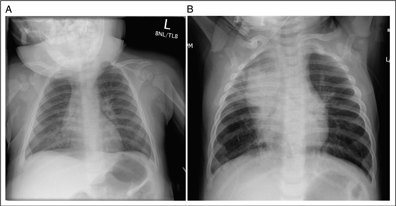

a chest xray with a large, open chest
  Portable chest radiograph of a 5monthold girl with fever cough and increased work of breathing The lungs are mildly hyperexpanded with perihilar interstitial prominence peribronchial cuffing and fine alveolar perihilar opacities There is a confluent density seen in the right mid lobe silhouetting the heart border  Portable chest radiograph of a 4monthold boy with fever cough and increased work of breathing The lungs are hyperinflated with multifocal atelectasis affecting the right upper lobe and medial lung bases bilaterally The airspace opacities affecting the right upper lobe are more confluent compared with elsewhere


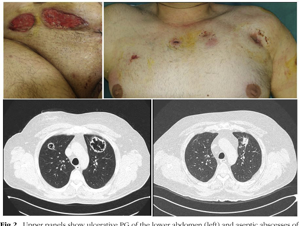

a man with a large lump on his chest
 Upper panels show ulcerative PG of the lower abdomen left and aseptic abscesses of the torso and arms right Lower panels show evident cavitations on CT scan of the chest at presentation left and their resolution after treatment with systemic immunosuppression right


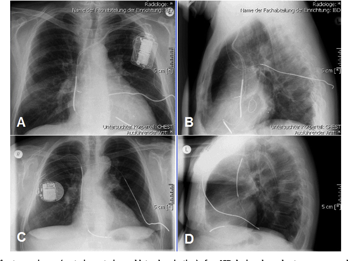

the chest and chest are shown in four different views
 e Chest xray image posterioranterior and lateral projection of an ICD device plus subcutaneous array electrode Panel  and  left sided ICD implantation Panel  and  right sided ICD implantation


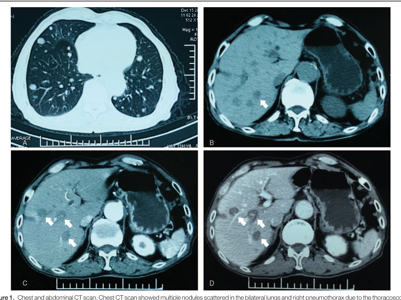

ct scan ct scan
 Chest and abdominal CT scan Chest CT scan showedmultiple nodules s These lesions were well circumscribed ranging from a few millimeters to 10cm in The abdominal CT scan showed multiple hepatic lowdensity masses arrows Fig hypoenhanced in both the arterial and portal venous phases  and 


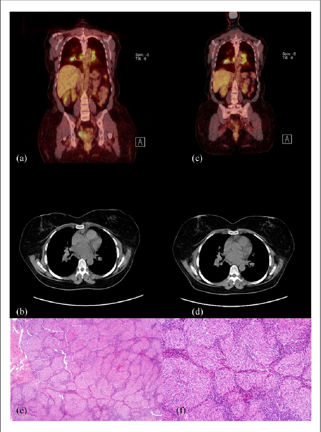

the left side of the ctd mri shows the left side of the ctd mri, and the right
 PETCT and pathology slides of case no 2 a b Initial PETCT and chest CT showing parahilar lymph nodes involvement c d PETCT and chest CT at 6 months showing stability of the lymph nodes Patient subsequently underwent endobronchial biopsy showing noncaseating granulomas consistent with sarcoidosis e Lymph node diffusely replaced by compact nonnecrotizing granulomas 4× f Granulomas are formed of clusters of epithelioid histiocytes and have well demarcated margins 10×


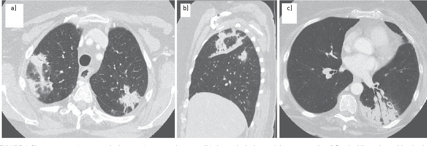

the left side of the chest shows the left side of the chest and the right side of the chest shows
FIGURE 1 Chest computed tomography images demonstrating consolidation typical of organising pneumonia a Patchy bilateral opacities in the upper lobes b sagittal reformatted image showing ringshaped airspace consolidation in the left upper lobe c consolidation with air bronchogram in the left lower lobe


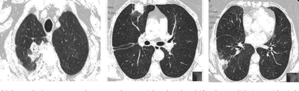

the brain is shown in this image, and shows the different areas of the brain
 Chest high resolution computed tomography  peripheral and multifocal consolidations with air bronchogram and a ground glass pattern


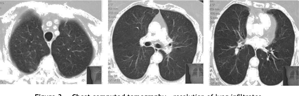

the radiology of the lungs shows the location of the lungs
 Chest computed tomography  resolution of lung infiltrates


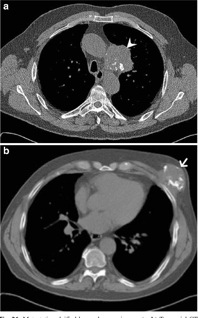

the ct scan shows the location of the ct in the brain
 Metastatic calcified lung adenocarcinoma a b Two axial CT images of the thorax show calcified lung adenocarcinoma arrowhead a and calcified soft tissue chest wall metastasis arrow b


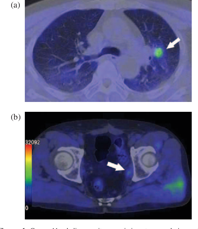

the left side of the brain shows the left side of the brain and the right side of the brain
 Carcon11 choline positron emission tomographycomputed tomography in a 71yearold man suffering from prostate cancer a Axial positron emission tomographycomputed tomography of the chest Abnormal uptake of C11 choline is observed in the small nodule of the left upper lobe arrows Pathologic diagnosis is metastasis of prostate cancer b Axial positron emission tomographycomputed tomography of the pelvis Image shows slight accumulation of C11 choline to the pelvic floor and left iliac node arrow


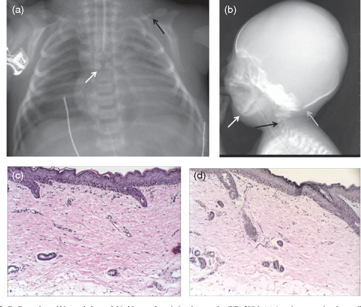

the left side of the chest shows the different areas of the chest and the right side of the chest
 Radiographs and histopathology of skin biopsy of restrictive dermopathy RD 5003 a Anterior–posterior chest radiograph of patient RD 5003 shows a butterfly vertebra at the thoracic 5 level white arrow Clavicles were dysmorphic with a pseudoarthrosis at the juncture of the middle and distal one thirds with the distal portions bulbous in appearance black arrow b Lateral radiograph of the skull of patient RD 5003 reveals prominent sutures gray arrow micrognathia white arrow and hypoplastic cervical vertebral bodies black arrow c Hematoxylin and eosin stain of skin biopsy shows the epidermis and dermis to be slightly attenuated and the dermis shows marked fibrosis and parallel collagen bundles d An elastic tissue stain Verhoeff van Gieson shows complete absence of elastic fibers throughout the dermis


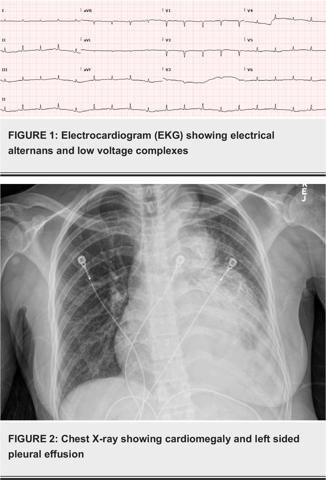

the chest and chest are shown in this image
FIGURE 2 Chest Xray showing cardiomegaly and left sided


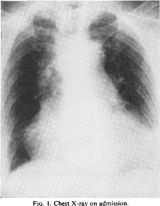

a chest with a large, black lung
FIG 1 Chest Xray on admission


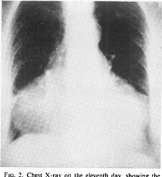

a chest with a large, black lung
FIG 2 Chest Xray on the eleventh day showing the development of right atrial enlargement


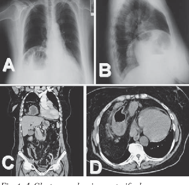

the left side of the chest shows the left side of the chest and the right side of the chest shows
  Chest xray showing unspecifi c changes of the right chest  profi le chest xray showing tumor formation in the right chest of unknown etiology  and  chest and abdominal multislice computed tomography showing Morgagni hernia


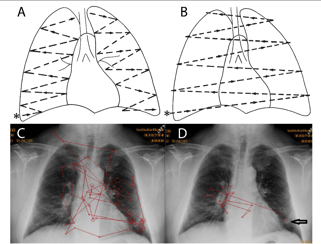

the left lung is shown in red and the right lung is shown in black
FIGURE 1  Reprinted from Goodman and Felson 2007 with permission AB Proposed lung search pattern  This commonly taught search pattern for examination of the lungs during chest radiograph CXR interpretation involves starting at the right base ∗ the costophrenic angle and examining the right and then left lungs   second look is then performed in order to compare the right and left lungs as bilateral symmetry is assumed to be useful in recognizing abnormalities Carmody et al 1984 Reprinted from Waite et al 2017a with permission Typical scanpaths of a novice  and an expert  radiologist both searching a CXR which has a nodule at the left base arrow in  This free search pattern  is typically employed by experts and differs from the formal radiologic training given in residency Instead it indicates the flexible use of search strategies as a function of immediate visual information The expert radiologist  has more efficient sca

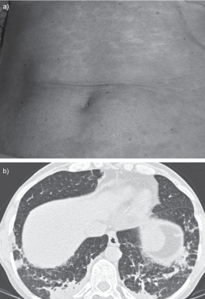

a mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
FIGURE 1 a Widespread maculopapular rash b Chest computed tomography showing bilateral micronodular lesions with groundglass and nonspecific consolidations and linear opacities mainly in the lower lobes c Results of drugpatch testing at day 2 for Malarone1 GlaxoSmithLkine Research Triangle Park NC USA atovaquone proguanil mefloquine chloroquine and quinine


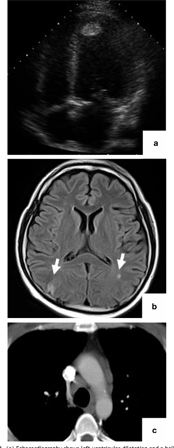

the brain and the brain are shown in this image
 a Echocardiography shows left ventricular dilatation and a balllike thrombus of approximately 1728 mm in the apex of the left ventricle b MRI of the brain shows small infarctions in the occipital lobe due to embolization arrows c Chest computed tomography reveals bilateral hilar lymphadenopathy


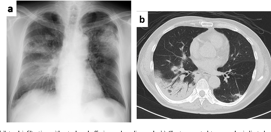

the left side of the chest shows the radiology of the chest and the right side shows the radiology
 a Chest Xray showed bilateral infiltration without pleural effusion and cardiomegaly b Chest computed tomography indicated nonsegmental patchy shadow and consolidation with air bronchogram


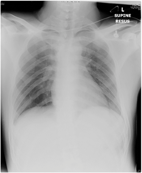

the chest is shown with a chest x - ray
 Chest  ray on arrival


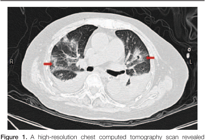

the mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri mri
  highresolution chest computed tomography scan revealed infiltration and air bronchograms in both lungs arrow heads and moderate pleural effusion with atelectasis of lower lobes of both lungs


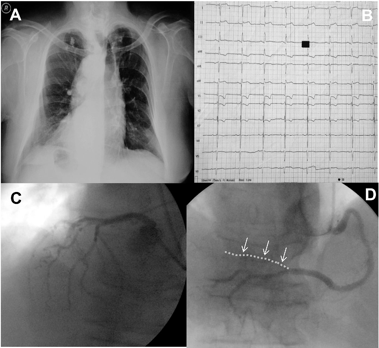

a radiograph of the chest and a radiograph of the chest
  Chest Xray confirming dextrocardia as well as the presence of a right sided stomach gas bubble and a right sided aortic knuckle  Leftsided ECG showing negative  waves in leads  and aVL positive  wave in aVR prominent  wave in the leftsided chest leads as well as prominent  wave in the rightsided chest leads and STelevation in leads  II III aVL and aVF  Left anterior oblique LAO view of the normal left coronary artery  Right anterior oblique RAO view of the right coronary artery RCA depicting the occluded posterolateral branch arrows and dotted line


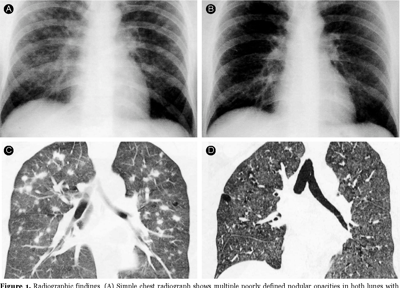

the chest and chest are shown in this image
 Radiographic findings  Simple chest radiograph shows multiple poorly defined nodular opacities in both lungs with sparing the costophrenic area  Chest radiograph after 15 months shows markedly decreased nodular opacities with remained coarse reticular opacities in both upper lungs  Coronal reconstructed imaging of chest CT shows multiple variable sized nodules predominantly in both upper lungs  Chest CT after 15 months reveals that previously noted lung nodules are disappeared


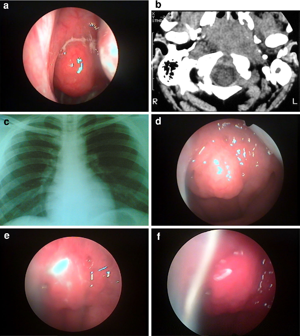

the four images show the different areas of the breast
 a smooth mass in nasopharynx b   features of a mass in nasopharynx c normal chest Xray d mass after 1 month of ATT e mass after 2 months of ATT f mass after 4 months of ATT


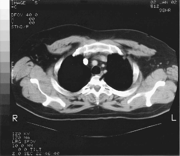

ct scan of the left side of the brain
 Chest CT demonstrating soft tissue mass in left upper lobe abutting the pleura


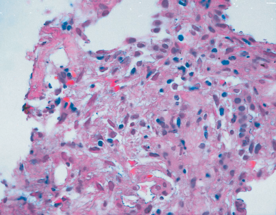

imbauen in the liver
 Chest CT demonstrating small noncalcified lesions in the left upper lobe


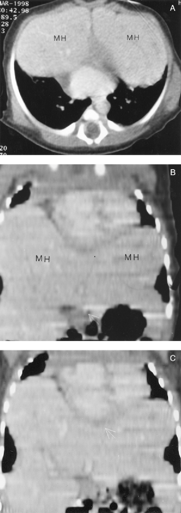

ct scan of the brain
 Axial   reconstructed coronal anteriorly    and reconstructed coronal  slightly more posteriorly At the level of the base of the heart are bilobed masses MH with the appearance of liver The coronal reconstructions show that there are bilateral central herniations of liver into the chest displacing the heart superiorly


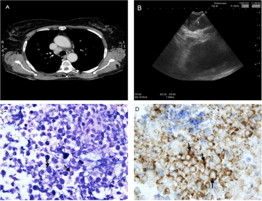

the left side of the left side shows the left side of the left side of the left side of the
   chest computed tomography showing an enlarged lower paratracheal lymphadenopathy  Endobronchial ultrasoundguided transbronchial needle aspiration of the lower paratracheal lymph node Station 4R white arrow points to the sampling needle inside the lower paratracheal lymph node  Large lymphocytes with atypia showing hyperchromatic nuclei with an irregular shape black arrows pointing large lymphocytes with hyperchromatic nuclei Mitosis and apoptosis were present Cell Block HE  1000  Vast majority of atypical lymphocytes with CD30positive cells black arrow pointing CD30positive cell Peroxidase ×1000


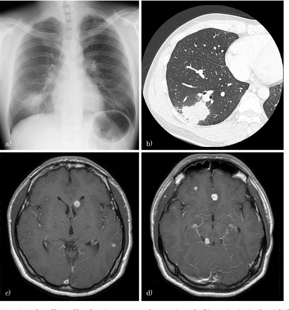

the left side of the chest shows the left side of the chest, and the right side shows the right
 a  chest Xray film showing a tumor of approximately 50 mm in size in the right lower field b  chest CT scan showing a 48×35 mm tumor with spiculation and notching on the right S910 c d  gadoliniumenhanced brain MRI scan showing multiple brain tumors with ring enhancement


In [17]:
from transformers import BlipForConditionalGeneration

# 1. Create an instance of the model using the original architecture
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

# 2. Load the saved state dictionary
# load_path = "/content/drive/MyDrive/CSC490/CSC490 Project/Models/fine_tuned_model_ex3.pth"
# model.load_state_dict(torch.load(load_path))

# 3. Set to evaluation mode (optional)
model.eval()

model.to(device)

gen_captions = []
for i in range(0, 300):
  gen_captions.append(generate_caption(i, dataset))

import pickle
file_path = '/content/drive/My Drive/CSC490/CSC490 Project/results/test_gen_captions_blip.pkl'

with open(file_path, 'wb') as file:
    pickle.dump(gen_captions, file)

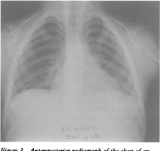

anteroposterior radiograph of the chest of an 86yearold man with a history of smoking history and a history of smoking history showing a large mass in the right upper lobe with a small amount of air bronchograms and
 Anteroposterior radiograph of the chest of an adolescent showing hypoplasia of the clavicles


['anteroposterior radiograph of the chest of an 86yearold man with a history of smoking history and a history of smoking history showing a large mass in the right upper lobe with a small amount of air bronchograms and',
 ' Anteroposterior radiograph of the chest of an adolescent showing hypoplasia of the clavicles']

In [ ]:
generate_caption(303, dataset)

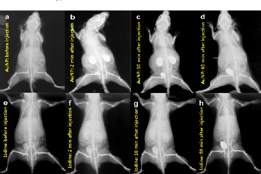

a – c and d a – d a – d a and d a – e a – e a – e a – e a and e a – e a – f a – e a – f a – e a – e a –
 Pharmacokinetics of AuNPs a–d and iodine contrast agent e–h in mice ae Before injection bf 2 min after injection cg 10 min after injection dh 60 min after injection The AuNPs show low liver and spleen uptake as well as clearance via kidneys and bladder b–d At 60 min d the contrast in the Auinjected mouse is similar to the uninjected mouse a indicating efficient clearance  Lorad Medical Systems mammography unit Hologic Inc Danbury CT USA model XDA101827 is used with 8 mAs exposures 04 s at 22 kVp Kodak MinR2000 mammography film 18 cm × 24 cm Eastman Kodak Rochester NY USA is used 50 Adapted by permission from The British Institute of Radiology


['a – c and d a – d a – d a and d a – e a – e a – e a – e a and e a – e a – f a – e a – f a – e a – e a –',
 ' Pharmacokinetics of AuNPs a–d and iodine contrast agent e–h in mice ae Before injection bf 2 min after injection cg 10 min after injection dh 60 min after injection The AuNPs show low liver and spleen uptake as well as clearance via kidneys and bladder b–d At 60 min d the contrast in the Auinjected mouse is similar to the uninjected mouse a indicating efficient clearance  Lorad Medical Systems mammography unit Hologic Inc Danbury CT USA model XDA101827 is used with 8 mAs exposures 04 s at 22 kVp Kodak MinR2000 mammography film 18 cm × 24 cm Eastman Kodak Rochester NY USA is used 50 Adapted by permission from The British Institute of Radiology']

In [ ]:
generate_caption(680, dataset)

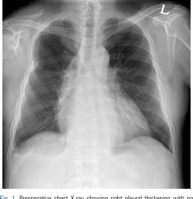

a chest with a large, open chest
 Preoperative chest Xray showing right pleural thickening with no active lung lesion


['a chest with a large, open chest',
 ' Preoperative chest Xray showing right pleural thickening with no active lung lesion']

In [ ]:
generate_caption(660, dataset) # max bert

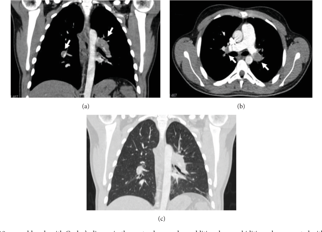

the left side of the chest shows the left side of the chest and the right side of the chest shows
 An 18yearold male with Crohn’s disease in the acute phase and no additional comorbidities who presented with mild shortness of breath Coronal and axial reconstruction of contrastenhanced chest CT reveals bilateral pulmonary embolism in both main pulmonary arteries arrows ab Coronal reconstruction for lung parenchyma c


['the left side of the chest shows the left side of the chest and the right side of the chest shows',
 ' An 18yearold male with Crohn’s disease in the acute phase and no additional comorbidities who presented with mild shortness of breath Coronal and axial reconstruction of contrastenhanced chest CT reveals bilateral pulmonary embolism in both main pulmonary arteries arrows ab Coronal reconstruction for lung parenchyma c']

In [ ]:
generate_caption(344, dataset) # min bert

In [ ]:
import pandas as pd
result_df = pd.DataFrame(gen_captions, columns=["generated_caption", "reference"])
result_df

,generated_caption,reference
0,a and c standard dose images b and d low dose ...,Contrastenhanced chest CT scans showed a tort...
1,contrastenhanced ct of the chest a and b show ...,Contrastenhanced chest CT scans showed differ...
2,chest xray showing a mass in the right upper lobe,FIGURE 1 Chest radiograph on admission showing...
3,computed tomography of the chest showing a mas...,Chest computed tomography scan at the time of...
4,computed tomography showed the bilateral paren...,Chest computed tomography showed the bilatera...
...,...,...
995,posteroanterior chest radiograph showing a lar...,FIG 3 The propositus V37 aged 15 xray showing ...
996,posttraumatic pneumomediastinum in a 57yearold...,Posttraumatic pneumomediastinum in a 45yearol...
997,bronchoscopic view of chest computed tomograph...,Preoperative situation Chest computed tomogr...
998,a coronary angiography of a patient with a pul...,Case 1 a Diagram of heart showing total obstr...


In [ ]:
# Save as new csv file
path = '/content/drive/My Drive/CSC490/CSC490 Project/results/validation_result.csv'
result_df.to_csv(path, index=False)